In [1]:
import math
import json
import os
import datetime

#PyData Packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb

#Sklearn Packages
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import MultiLabelBinarizer, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering

#Magic Commands
%matplotlib inline

In [2]:
portfolio = pd.read_json("./portfolio.json", orient = 'records', lines = True )

In [3]:
portfolio

,reward,channels,difficulty,duration,offer_type,id
0,10,"[email, mobile, social]",10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd
1,10,"[web, email, mobile, social]",10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0
2,0,"[web, email, mobile]",0,4,informational,3f207df678b143eea3cee63160fa8bed
3,5,"[web, email, mobile]",5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9
4,5,"[web, email]",20,10,discount,0b1e1539f2cc45b7b9fa7c272da2e1d7
5,3,"[web, email, mobile, social]",7,7,discount,2298d6c36e964ae4a3e7e9706d1fb8c2
6,2,"[web, email, mobile, social]",10,10,discount,fafdcd668e3743c1bb461111dcafc2a4
7,0,"[email, mobile, social]",0,3,informational,5a8bc65990b245e5a138643cd4eb9837
8,5,"[web, email, mobile, social]",5,5,bogo,f19421c1d4aa40978ebb69ca19b0e20d
9,2,"[web, email, mobile]",10,7,discount,2906b810c7d4411798c6938adc9daaa5


In [4]:
portfolio.shape

(10, 6)

In [5]:
profile = pd.read_json("./profile.json", orient = 'records', lines = True )

In [6]:
profile.head()

,gender,age,id,became_member_on,income
0,None,118,68be06ca386d4c31939f3a4f0e3dd783,20170212,NaN
1,F,55,0610b486422d4921ae7d2bf64640c50b,20170715,112000.0
2,None,118,38fe809add3b4fcf9315a9694bb96ff5,20180712,NaN
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,20170509,100000.0
4,None,118,a03223e636434f42ac4c3df47e8bac43,20170804,NaN


In [7]:
profile.shape

(17000, 5)

In [8]:
transcript = pd.read_json("./transcript.json", orient = 'records', lines = True )

In [9]:
transcript.head()

,person,event,value,time
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0
1,a03223e636434f42ac4c3df47e8bac43,offer received,{'offer id': '0b1e1539f2cc45b7b9fa7c272da2e1d7'},0
2,e2127556f4f64592b11af22de27a7932,offer received,{'offer id': '2906b810c7d4411798c6938adc9daaa5'},0
3,8ec6ce2a7e7949b1bf142def7d0e0586,offer received,{'offer id': 'fafdcd668e3743c1bb461111dcafc2a4'},0
4,68617ca6246f4fbc85e91a2a49552598,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0


In [10]:
transcript.shape

(306534, 4)

In [11]:
portfolio.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   reward      10 non-null     int64 
 1   channels    10 non-null     object
 2   difficulty  10 non-null     int64 
 3   duration    10 non-null     int64 
 4   offer_type  10 non-null     object
 5   id          10 non-null     object
dtypes: int64(3), object(3)
memory usage: 608.0+ bytes


In [12]:
profile.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17000 entries, 0 to 16999
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   gender            14825 non-null  object 
 1   age               17000 non-null  int64  
 2   id                17000 non-null  object 
 3   became_member_on  17000 non-null  int64  
 4   income            14825 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 664.2+ KB


In [13]:
transcript.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 306534 entries, 0 to 306533
Data columns (total 4 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   person  306534 non-null  object
 1   event   306534 non-null  object
 2   value   306534 non-null  object
 3   time    306534 non-null  int64 
dtypes: int64(1), object(3)
memory usage: 9.4+ MB


### Portfolio Dataset Cleaning

In [14]:
portfolio['offer_type'].value_counts()

bogo             4
discount         4
informational    2
Name: offer_type, dtype: int64

In [15]:
portfolio['channels'].astype('str').value_counts()

['web', 'email', 'mobile', 'social']    4
['web', 'email', 'mobile']              3
['email', 'mobile', 'social']           2
['web', 'email']                        1
Name: channels, dtype: int64

In [16]:
portfolio

,reward,channels,difficulty,duration,offer_type,id
0,10,"[email, mobile, social]",10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd
1,10,"[web, email, mobile, social]",10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0
2,0,"[web, email, mobile]",0,4,informational,3f207df678b143eea3cee63160fa8bed
3,5,"[web, email, mobile]",5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9
4,5,"[web, email]",20,10,discount,0b1e1539f2cc45b7b9fa7c272da2e1d7
5,3,"[web, email, mobile, social]",7,7,discount,2298d6c36e964ae4a3e7e9706d1fb8c2
6,2,"[web, email, mobile, social]",10,10,discount,fafdcd668e3743c1bb461111dcafc2a4
7,0,"[email, mobile, social]",0,3,informational,5a8bc65990b245e5a138643cd4eb9837
8,5,"[web, email, mobile, social]",5,5,bogo,f19421c1d4aa40978ebb69ca19b0e20d
9,2,"[web, email, mobile]",10,7,discount,2906b810c7d4411798c6938adc9daaa5


In [17]:
portfolio.rename(columns={'id' : 'offer_id'}, inplace=True)

In [18]:
portfolio

,reward,channels,difficulty,duration,offer_type,offer_id
0,10,"[email, mobile, social]",10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd
1,10,"[web, email, mobile, social]",10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0
2,0,"[web, email, mobile]",0,4,informational,3f207df678b143eea3cee63160fa8bed
3,5,"[web, email, mobile]",5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9
4,5,"[web, email]",20,10,discount,0b1e1539f2cc45b7b9fa7c272da2e1d7
5,3,"[web, email, mobile, social]",7,7,discount,2298d6c36e964ae4a3e7e9706d1fb8c2
6,2,"[web, email, mobile, social]",10,10,discount,fafdcd668e3743c1bb461111dcafc2a4
7,0,"[email, mobile, social]",0,3,informational,5a8bc65990b245e5a138643cd4eb9837
8,5,"[web, email, mobile, social]",5,5,bogo,f19421c1d4aa40978ebb69ca19b0e20d
9,2,"[web, email, mobile]",10,7,discount,2906b810c7d4411798c6938adc9daaa5


In [19]:
portfolio.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   reward      10 non-null     int64 
 1   channels    10 non-null     object
 2   difficulty  10 non-null     int64 
 3   duration    10 non-null     int64 
 4   offer_type  10 non-null     object
 5   offer_id    10 non-null     object
dtypes: int64(3), object(3)
memory usage: 608.0+ bytes


In [20]:
offer_dummies = pd.get_dummies(portfolio['offer_type'], prefix='offer')

In [21]:
portfolio = pd.concat([portfolio, offer_dummies], axis=1)

In [22]:
portfolio.head()

,reward,channels,difficulty,duration,offer_type,offer_id,offer_bogo,offer_discount,offer_informational
0,10,"[email, mobile, social]",10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd,1,0,0
1,10,"[web, email, mobile, social]",10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0,1,0,0
2,0,"[web, email, mobile]",0,4,informational,3f207df678b143eea3cee63160fa8bed,0,0,1
3,5,"[web, email, mobile]",5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9,1,0,0
4,5,"[web, email]",20,10,discount,0b1e1539f2cc45b7b9fa7c272da2e1d7,0,1,0


In [23]:
channels_one_hot = MultiLabelBinarizer()
sep_channels = channels_one_hot.fit_transform(portfolio['channels'])

In [24]:
sep_channels

array([[1, 1, 1, 0],
       [1, 1, 1, 1],
       [1, 1, 0, 1],
       [1, 1, 0, 1],
       [1, 0, 0, 1],
       [1, 1, 1, 1],
       [1, 1, 1, 1],
       [1, 1, 1, 0],
       [1, 1, 1, 1],
       [1, 1, 0, 1]])

In [25]:
pd.DataFrame(data = sep_channels, columns = channels_one_hot.classes_)

,email,mobile,social,web
0,1,1,1,0
1,1,1,1,1
2,1,1,0,1
3,1,1,0,1
4,1,0,0,1
5,1,1,1,1
6,1,1,1,1
7,1,1,1,0
8,1,1,1,1
9,1,1,0,1


In [26]:
channels_df = pd.DataFrame(data = sep_channels, columns = channels_one_hot.classes_)

In [27]:
portfolio = pd.concat([portfolio, channels_df], axis = 1)

In [28]:
portfolio

,reward,channels,difficulty,duration,offer_type,offer_id,offer_bogo,offer_discount,offer_informational,email,mobile,social,web
0,10,"[email, mobile, social]",10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd,1,0,0,1,1,1,0
1,10,"[web, email, mobile, social]",10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0,1,0,0,1,1,1,1
2,0,"[web, email, mobile]",0,4,informational,3f207df678b143eea3cee63160fa8bed,0,0,1,1,1,0,1
3,5,"[web, email, mobile]",5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9,1,0,0,1,1,0,1
4,5,"[web, email]",20,10,discount,0b1e1539f2cc45b7b9fa7c272da2e1d7,0,1,0,1,0,0,1
5,3,"[web, email, mobile, social]",7,7,discount,2298d6c36e964ae4a3e7e9706d1fb8c2,0,1,0,1,1,1,1
6,2,"[web, email, mobile, social]",10,10,discount,fafdcd668e3743c1bb461111dcafc2a4,0,1,0,1,1,1,1
7,0,"[email, mobile, social]",0,3,informational,5a8bc65990b245e5a138643cd4eb9837,0,0,1,1,1,1,0
8,5,"[web, email, mobile, social]",5,5,bogo,f19421c1d4aa40978ebb69ca19b0e20d,1,0,0,1,1,1,1
9,2,"[web, email, mobile]",10,7,discount,2906b810c7d4411798c6938adc9daaa5,0,1,0,1,1,0,1


In [29]:
portfolio.rename(columns={'email' : 'channel_email', 'mobile' : 'channel_mobile', 'social' : 'channel_social', 'web' : 'channel_web'}, inplace = True)

In [30]:
portfolio

,reward,channels,difficulty,duration,offer_type,offer_id,offer_bogo,offer_discount,offer_informational,channel_email,channel_mobile,channel_social,channel_web
0,10,"[email, mobile, social]",10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd,1,0,0,1,1,1,0
1,10,"[web, email, mobile, social]",10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0,1,0,0,1,1,1,1
2,0,"[web, email, mobile]",0,4,informational,3f207df678b143eea3cee63160fa8bed,0,0,1,1,1,0,1
3,5,"[web, email, mobile]",5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9,1,0,0,1,1,0,1
4,5,"[web, email]",20,10,discount,0b1e1539f2cc45b7b9fa7c272da2e1d7,0,1,0,1,0,0,1
5,3,"[web, email, mobile, social]",7,7,discount,2298d6c36e964ae4a3e7e9706d1fb8c2,0,1,0,1,1,1,1
6,2,"[web, email, mobile, social]",10,10,discount,fafdcd668e3743c1bb461111dcafc2a4,0,1,0,1,1,1,1
7,0,"[email, mobile, social]",0,3,informational,5a8bc65990b245e5a138643cd4eb9837,0,0,1,1,1,1,0
8,5,"[web, email, mobile, social]",5,5,bogo,f19421c1d4aa40978ebb69ca19b0e20d,1,0,0,1,1,1,1
9,2,"[web, email, mobile]",10,7,discount,2906b810c7d4411798c6938adc9daaa5,0,1,0,1,1,0,1


In [31]:
portfolio.drop(columns=['channels', 'offer_type'], inplace=True)

In [32]:
portfolio

,reward,difficulty,duration,offer_id,offer_bogo,offer_discount,offer_informational,channel_email,channel_mobile,channel_social,channel_web
0,10,10,7,ae264e3637204a6fb9bb56bc8210ddfd,1,0,0,1,1,1,0
1,10,10,5,4d5c57ea9a6940dd891ad53e9dbe8da0,1,0,0,1,1,1,1
2,0,0,4,3f207df678b143eea3cee63160fa8bed,0,0,1,1,1,0,1
3,5,5,7,9b98b8c7a33c4b65b9aebfe6a799e6d9,1,0,0,1,1,0,1
4,5,20,10,0b1e1539f2cc45b7b9fa7c272da2e1d7,0,1,0,1,0,0,1
5,3,7,7,2298d6c36e964ae4a3e7e9706d1fb8c2,0,1,0,1,1,1,1
6,2,10,10,fafdcd668e3743c1bb461111dcafc2a4,0,1,0,1,1,1,1
7,0,0,3,5a8bc65990b245e5a138643cd4eb9837,0,0,1,1,1,1,0
8,5,5,5,f19421c1d4aa40978ebb69ca19b0e20d,1,0,0,1,1,1,1
9,2,10,7,2906b810c7d4411798c6938adc9daaa5,0,1,0,1,1,0,1


In [33]:
portfolio.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 11 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   reward               10 non-null     int64 
 1   difficulty           10 non-null     int64 
 2   duration             10 non-null     int64 
 3   offer_id             10 non-null     object
 4   offer_bogo           10 non-null     uint8 
 5   offer_discount       10 non-null     uint8 
 6   offer_informational  10 non-null     uint8 
 7   channel_email        10 non-null     int32 
 8   channel_mobile       10 non-null     int32 
 9   channel_social       10 non-null     int32 
 10  channel_web          10 non-null     int32 
dtypes: int32(4), int64(3), object(1), uint8(3)
memory usage: 638.0+ bytes


## Profile Dataset Cleaning

In [34]:
profile.head()

,gender,age,id,became_member_on,income
0,None,118,68be06ca386d4c31939f3a4f0e3dd783,20170212,NaN
1,F,55,0610b486422d4921ae7d2bf64640c50b,20170715,112000.0
2,None,118,38fe809add3b4fcf9315a9694bb96ff5,20180712,NaN
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,20170509,100000.0
4,None,118,a03223e636434f42ac4c3df47e8bac43,20170804,NaN


In [35]:
profile.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17000 entries, 0 to 16999
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   gender            14825 non-null  object 
 1   age               17000 non-null  int64  
 2   id                17000 non-null  object 
 3   became_member_on  17000 non-null  int64  
 4   income            14825 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 664.2+ KB


In [36]:
profile['gender'].value_counts(dropna=False)

M      8484
F      6129
NaN    2175
O       212
Name: gender, dtype: int64

In [37]:
profile['age'].value_counts()

118    2175
58      408
53      372
51      363
54      359
       ... 
100      12
96        8
98        5
101       5
99        5
Name: age, Length: 85, dtype: int64

In [38]:
profile.dropna(inplace=True)

In [39]:
profile.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14825 entries, 1 to 16999
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   gender            14825 non-null  object 
 1   age               14825 non-null  int64  
 2   id                14825 non-null  object 
 3   became_member_on  14825 non-null  int64  
 4   income            14825 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 694.9+ KB


In [40]:
profile.rename(columns={'id' : 'customer_id'}, inplace = True)

In [41]:
profile

,gender,age,customer_id,became_member_on,income
1,F,55,0610b486422d4921ae7d2bf64640c50b,20170715,112000.0
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,20170509,100000.0
5,M,68,e2127556f4f64592b11af22de27a7932,20180426,70000.0
8,M,65,389bc3fa690240e798340f5a15918d5c,20180209,53000.0
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,20171111,51000.0
...,...,...,...,...,...
16995,F,45,6d5f3a774f3d4714ab0c092238f3a1d7,20180604,54000.0
16996,M,61,2cb4f97358b841b9a9773a7aa05a9d77,20180713,72000.0
16997,M,49,01d26f638c274aa0b965d24cefe3183f,20170126,73000.0
16998,F,83,9dc1421481194dcd9400aec7c9ae6366,20160307,50000.0


In [42]:
profile['became_member_on'] = profile['became_member_on'].apply(lambda x: datetime.datetime.strptime(str(x), "%Y%m%d").date())

In [43]:
profile.head()

,gender,age,customer_id,became_member_on,income
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0
5,M,68,e2127556f4f64592b11af22de27a7932,2018-04-26,70000.0
8,M,65,389bc3fa690240e798340f5a15918d5c,2018-02-09,53000.0
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,2017-11-11,51000.0


In [44]:
end_date = pd.Timestamp('2018-08-01')
end_date

Timestamp('2018-08-01 00:00:00')

In [45]:
end_date = pd.to_datetime(end_date)
end_date

Timestamp('2018-08-01 00:00:00')

In [46]:
profile['days_as_member'] = np.abs((pd.to_datetime(profile['became_member_on']) - end_date).dt.days)

In [47]:
#profile.drop(columns={''}, axis = 1, inplace = True)

In [48]:
profile.head()

,gender,age,customer_id,became_member_on,income,days_as_member
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0,382
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0,449
5,M,68,e2127556f4f64592b11af22de27a7932,2018-04-26,70000.0,97
8,M,65,389bc3fa690240e798340f5a15918d5c,2018-02-09,53000.0,173
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,2017-11-11,51000.0,263


In [49]:
age_range_labels = ['11-19', '20-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80+']
age_range_bins = [11, 20, 30, 40, 50, 60, 70, 80, 110]
pd.cut(profile['age'], bins=age_range_bins, labels = age_range_labels, right=False)

1        50-59
3        70-79
5        60-69
8        60-69
12       50-59
         ...  
16995    40-49
16996    60-69
16997    40-49
16998      80+
16999    60-69
Name: age, Length: 14825, dtype: category
Categories (8, object): ['11-19' < '20-29' < '30-39' < '40-49' < '50-59' < '60-69' < '70-79' < '80+']

In [50]:
profile['age_range'] = pd.cut(profile['age'], bins=age_range_bins, labels = age_range_labels, right=False)
profile

,gender,age,customer_id,became_member_on,income,days_as_member,age_range
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0,382,50-59
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0,449,70-79
5,M,68,e2127556f4f64592b11af22de27a7932,2018-04-26,70000.0,97,60-69
8,M,65,389bc3fa690240e798340f5a15918d5c,2018-02-09,53000.0,173,60-69
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,2017-11-11,51000.0,263,50-59
...,...,...,...,...,...,...,...
16995,F,45,6d5f3a774f3d4714ab0c092238f3a1d7,2018-06-04,54000.0,58,40-49
16996,M,61,2cb4f97358b841b9a9773a7aa05a9d77,2018-07-13,72000.0,19,60-69
16997,M,49,01d26f638c274aa0b965d24cefe3183f,2017-01-26,73000.0,552,40-49
16998,F,83,9dc1421481194dcd9400aec7c9ae6366,2016-03-07,50000.0,877,80+


In [51]:
pd.Categorical(profile['age_range'], ordered = True, categories = age_range_labels)

['50-59', '70-79', '60-69', '60-69', '50-59', ..., '40-49', '60-69', '40-49', '80+', '60-69']
Length: 14825
Categories (8, object): ['11-19' < '20-29' < '30-39' < '40-49' < '50-59' < '60-69' < '70-79' < '80+']

In [52]:
profile['age_range'] = pd.Categorical(profile['age_range'], ordered = True, categories = age_range_labels)

In [53]:
profile

,gender,age,customer_id,became_member_on,income,days_as_member,age_range
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0,382,50-59
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0,449,70-79
5,M,68,e2127556f4f64592b11af22de27a7932,2018-04-26,70000.0,97,60-69
8,M,65,389bc3fa690240e798340f5a15918d5c,2018-02-09,53000.0,173,60-69
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,2017-11-11,51000.0,263,50-59
...,...,...,...,...,...,...,...
16995,F,45,6d5f3a774f3d4714ab0c092238f3a1d7,2018-06-04,54000.0,58,40-49
16996,M,61,2cb4f97358b841b9a9773a7aa05a9d77,2018-07-13,72000.0,19,60-69
16997,M,49,01d26f638c274aa0b965d24cefe3183f,2017-01-26,73000.0,552,40-49
16998,F,83,9dc1421481194dcd9400aec7c9ae6366,2016-03-07,50000.0,877,80+


## Transcript Dataset Cleaning

In [54]:
transcript.head()

,person,event,value,time
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0
1,a03223e636434f42ac4c3df47e8bac43,offer received,{'offer id': '0b1e1539f2cc45b7b9fa7c272da2e1d7'},0
2,e2127556f4f64592b11af22de27a7932,offer received,{'offer id': '2906b810c7d4411798c6938adc9daaa5'},0
3,8ec6ce2a7e7949b1bf142def7d0e0586,offer received,{'offer id': 'fafdcd668e3743c1bb461111dcafc2a4'},0
4,68617ca6246f4fbc85e91a2a49552598,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0


In [55]:
transcript.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 306534 entries, 0 to 306533
Data columns (total 4 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   person  306534 non-null  object
 1   event   306534 non-null  object
 2   value   306534 non-null  object
 3   time    306534 non-null  int64 
dtypes: int64(1), object(3)
memory usage: 9.4+ MB


In [56]:
transcript['event'].value_counts()

transaction        138953
offer received      76277
offer viewed        57725
offer completed     33579
Name: event, dtype: int64

In [57]:
transcript.sample(10)

,person,event,value,time
214050,aed59d1f47be4f73ba402ede49666b7a,offer received,{'offer id': '2298d6c36e964ae4a3e7e9706d1fb8c2'},504
105386,c98c6fb3dcfa4c92b8e329a216e83e62,transaction,{'amount': 2.42},300
236690,1a2c6fd57fad4250b35c1b0903ed34ea,transaction,{'amount': 0.55},546
270094,751c9dd9226043c9a0d9206d53729936,offer viewed,{'offer id': '5a8bc65990b245e5a138643cd4eb9837'},594
62816,8acf438172ca4227a316f54b8f4d5477,offer received,{'offer id': 'ae264e3637204a6fb9bb56bc8210ddfd'},168
58122,b972e8204dfa438c852cab3a9f966a5e,offer received,{'offer id': '3f207df678b143eea3cee63160fa8bed'},168
167194,ce7ac21bc5f84d62bbbbe793f10f42e0,offer viewed,{'offer id': 'f19421c1d4aa40978ebb69ca19b0e20d'},408
63766,3daa3d4af82f4fdda3d70b11b4c6d29f,offer received,{'offer id': '2298d6c36e964ae4a3e7e9706d1fb8c2'},168
85442,2cad48dcddc44f9dac43c2d9b476535b,transaction,{'amount': 2.19},216
257174,5b4113bf2dd14ca6b4219cea5984e812,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},576


In [58]:
transcript.rename(columns={'person' : 'customer_id'}, inplace=True)

In [59]:
transcript

,customer_id,event,value,time
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0
1,a03223e636434f42ac4c3df47e8bac43,offer received,{'offer id': '0b1e1539f2cc45b7b9fa7c272da2e1d7'},0
2,e2127556f4f64592b11af22de27a7932,offer received,{'offer id': '2906b810c7d4411798c6938adc9daaa5'},0
3,8ec6ce2a7e7949b1bf142def7d0e0586,offer received,{'offer id': 'fafdcd668e3743c1bb461111dcafc2a4'},0
4,68617ca6246f4fbc85e91a2a49552598,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0
...,...,...,...,...
306529,b3a1272bc9904337b331bf348c3e8c17,transaction,{'amount': 1.5899999999999999},714
306530,68213b08d99a4ae1b0dcb72aebd9aa35,transaction,{'amount': 9.53},714
306531,a00058cf10334a308c68e7631c529907,transaction,{'amount': 3.61},714
306532,76ddbd6576844afe811f1a3c0fbb5bec,transaction,{'amount': 3.5300000000000002},714


In [60]:
profile

,gender,age,customer_id,became_member_on,income,days_as_member,age_range
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0,382,50-59
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0,449,70-79
5,M,68,e2127556f4f64592b11af22de27a7932,2018-04-26,70000.0,97,60-69
8,M,65,389bc3fa690240e798340f5a15918d5c,2018-02-09,53000.0,173,60-69
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,2017-11-11,51000.0,263,50-59
...,...,...,...,...,...,...,...
16995,F,45,6d5f3a774f3d4714ab0c092238f3a1d7,2018-06-04,54000.0,58,40-49
16996,M,61,2cb4f97358b841b9a9773a7aa05a9d77,2018-07-13,72000.0,19,60-69
16997,M,49,01d26f638c274aa0b965d24cefe3183f,2017-01-26,73000.0,552,40-49
16998,F,83,9dc1421481194dcd9400aec7c9ae6366,2016-03-07,50000.0,877,80+


In [61]:
pd.merge(left = transcript, right = profile, how = 'inner', left_on = 'customer_id', right_on = 'customer_id')

,customer_id,event,value,time,gender,age,became_member_on,income,days_as_member,age_range
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,F,75,2017-05-09,100000.0,449,70-79
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},6,F,75,2017-05-09,100000.0,449,70-79
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},132,F,75,2017-05-09,100000.0,449,70-79
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,132,F,75,2017-05-09,100000.0,449,70-79
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},144,F,75,2017-05-09,100000.0,449,70-79
...,...,...,...,...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},504,M,47,2017-10-13,94000.0,292,40-49
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576,M,47,2017-10-13,94000.0,292,40-49
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576,M,47,2017-10-13,94000.0,292,40-49
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576,F,58,2016-10-20,78000.0,650,50-59


In [62]:
transcript = pd.merge(left = transcript, right = profile, how = 'inner', left_on = 'customer_id', right_on = 'customer_id')
transcript.head()

,customer_id,event,value,time,gender,age,became_member_on,income,days_as_member,age_range
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,F,75,2017-05-09,100000.0,449,70-79
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},6,F,75,2017-05-09,100000.0,449,70-79
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},132,F,75,2017-05-09,100000.0,449,70-79
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,132,F,75,2017-05-09,100000.0,449,70-79
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},144,F,75,2017-05-09,100000.0,449,70-79


In [63]:
transcript.drop(columns = {'age', 'became_member_on', 'gender', 'income', 'days_as_member', 'age_range'})

,customer_id,event,value,time
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},6
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},132
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,132
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},144
...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},504
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576


In [64]:
transcript = transcript.drop(columns = {'age', 'became_member_on', 'gender', 'income', 'days_as_member', 'age_range'})
transcript

,customer_id,event,value,time
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},6
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},132
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,132
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},144
...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},504
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576


In [65]:
transcript.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 272762 entries, 0 to 272761
Data columns (total 4 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   customer_id  272762 non-null  object
 1   event        272762 non-null  object
 2   value        272762 non-null  object
 3   time         272762 non-null  int64 
dtypes: int64(1), object(3)
memory usage: 10.4+ MB


In [66]:
event_dummies = pd.get_dummies(transcript['event'])
event_dummies

,offer completed,offer received,offer viewed,transaction
0,0,1,0,0
1,0,0,1,0
2,0,0,0,1
3,1,0,0,0
4,0,0,0,1
...,...,...,...,...
272757,0,0,1,0
272758,0,1,0,0
272759,0,0,1,0
272760,0,1,0,0


In [67]:
event_dummies.rename(columns = {'offer completed' : 'offer_completed', 'offer received' : 'offer_received', 'offer viewed' : 'offer_viewed'}, inplace=True)
event_dummies

,offer_completed,offer_received,offer_viewed,transaction
0,0,1,0,0
1,0,0,1,0
2,0,0,0,1
3,1,0,0,0
4,0,0,0,1
...,...,...,...,...
272757,0,0,1,0
272758,0,1,0,0
272759,0,0,1,0
272760,0,1,0,0


In [68]:
transcript = pd.concat([transcript, event_dummies], axis = 1)
transcript

,customer_id,event,value,time,offer_completed,offer_received,offer_viewed,transaction
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,0,1,0,0
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},6,0,0,1,0
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},132,0,0,0,1
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,132,1,0,0,0
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},144,0,0,0,1
...,...,...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},504,0,0,1,0
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576,0,1,0,0
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576,0,0,1,0
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},576,0,1,0,0


In [69]:
transcript['days'] = transcript['time']/24

In [70]:
transcript.drop(columns=['time'], inplace=True)
transcript

,customer_id,event,value,offer_completed,offer_received,offer_viewed,transaction,days
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,1,0,0,0.00
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,0,1,0,0.25
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},0,0,0,1,5.50
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,1,0,0,0,5.50
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},0,0,0,1,6.00
...,...,...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},0,0,1,0,21.00
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,0,1,0,24.00
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00


In [71]:
transcript.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 272762 entries, 0 to 272761
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   customer_id      272762 non-null  object 
 1   event            272762 non-null  object 
 2   value            272762 non-null  object 
 3   offer_completed  272762 non-null  uint8  
 4   offer_received   272762 non-null  uint8  
 5   offer_viewed     272762 non-null  uint8  
 6   transaction      272762 non-null  uint8  
 7   days             272762 non-null  float64
dtypes: float64(1), object(3), uint8(4)
memory usage: 11.4+ MB


In [72]:
transcript['value']

0          {'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'}
1          {'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'}
2                                         {'amount': 19.89}
3         {'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...
4                                         {'amount': 17.78}
                                ...                        
272757     {'offer id': '3f207df678b143eea3cee63160fa8bed'}
272758     {'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'}
272759     {'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'}
272760     {'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'}
272761     {'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'}
Name: value, Length: 272762, dtype: object

In [73]:
transcript['offer-or-amount'] = transcript['value'].apply(lambda x: list(x.keys())[0])
transcript

,customer_id,event,value,offer_completed,offer_received,offer_viewed,transaction,days,offer-or-amount
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,1,0,0,0.00,offer id
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,0,1,0,0.25,offer id
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},0,0,0,1,5.50,amount
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,1,0,0,0,5.50,offer_id
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},0,0,0,1,6.00,amount
...,...,...,...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},0,0,1,0,21.00,offer id
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer id
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,0,1,0,24.00,offer id
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer id


In [74]:
transcript['value'].apply(lambda x: list(x.values())[0])

0         9b98b8c7a33c4b65b9aebfe6a799e6d9
1         9b98b8c7a33c4b65b9aebfe6a799e6d9
2                                    19.89
3         9b98b8c7a33c4b65b9aebfe6a799e6d9
4                                    17.78
                        ...               
272757    3f207df678b143eea3cee63160fa8bed
272758    4d5c57ea9a6940dd891ad53e9dbe8da0
272759    4d5c57ea9a6940dd891ad53e9dbe8da0
272760    4d5c57ea9a6940dd891ad53e9dbe8da0
272761    4d5c57ea9a6940dd891ad53e9dbe8da0
Name: value, Length: 272762, dtype: object

In [75]:
transcript['id-or-amount'] = transcript['value'].apply(lambda x: list(x.values())[0])
transcript

,customer_id,event,value,offer_completed,offer_received,offer_viewed,transaction,days,offer-or-amount,id-or-amount
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,1,0,0,0.00,offer id,9b98b8c7a33c4b65b9aebfe6a799e6d9
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,0,1,0,0.25,offer id,9b98b8c7a33c4b65b9aebfe6a799e6d9
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},0,0,0,1,5.50,amount,19.89
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,1,0,0,0,5.50,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},0,0,0,1,6.00,amount,17.78
...,...,...,...,...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},0,0,1,0,21.00,offer id,3f207df678b143eea3cee63160fa8bed
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer id,4d5c57ea9a6940dd891ad53e9dbe8da0
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,0,1,0,24.00,offer id,4d5c57ea9a6940dd891ad53e9dbe8da0
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer id,4d5c57ea9a6940dd891ad53e9dbe8da0


In [76]:
trans_offer_dict = {'offer id': 'offer_id'}
transcript['offer-or-amount'].replace(trans_offer_dict, inplace = True)

In [77]:
transcript

,customer_id,event,value,offer_completed,offer_received,offer_viewed,transaction,days,offer-or-amount,id-or-amount
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,1,0,0,0.00,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,0,1,0,0.25,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},0,0,0,1,5.50,amount,19.89
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,1,0,0,0,5.50,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},0,0,0,1,6.00,amount,17.78
...,...,...,...,...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},0,0,1,0,21.00,offer_id,3f207df678b143eea3cee63160fa8bed
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,0,1,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0


In [78]:
transcript[transcript['offer-or-amount'] == 'offer_id']

,customer_id,event,value,offer_completed,offer_received,offer_viewed,transaction,days,offer-or-amount,id-or-amount
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,1,0,0,0.00,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,0,1,0,0.25,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,1,0,0,0,5.50,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
5,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '5a8bc65990b245e5a138643cd4eb9837'},0,1,0,0,7.00,offer_id,5a8bc65990b245e5a138643cd4eb9837
6,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '5a8bc65990b245e5a138643cd4eb9837'},0,0,1,0,9.00,offer_id,5a8bc65990b245e5a138643cd4eb9837
...,...,...,...,...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},0,0,1,0,21.00,offer_id,3f207df678b143eea3cee63160fa8bed
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,0,1,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0


In [79]:
transcript_offer = transcript[transcript['offer-or-amount'] == 'offer_id']

In [80]:
transcript_offer

,customer_id,event,value,offer_completed,offer_received,offer_viewed,transaction,days,offer-or-amount,id-or-amount
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,1,0,0,0.00,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,0,1,0,0.25,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,1,0,0,0,5.50,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
5,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '5a8bc65990b245e5a138643cd4eb9837'},0,1,0,0,7.00,offer_id,5a8bc65990b245e5a138643cd4eb9837
6,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '5a8bc65990b245e5a138643cd4eb9837'},0,0,1,0,9.00,offer_id,5a8bc65990b245e5a138643cd4eb9837
...,...,...,...,...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},0,0,1,0,21.00,offer_id,3f207df678b143eea3cee63160fa8bed
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,0,1,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0


In [81]:
transcript_offer.rename(columns={'id-or-amount' : 'offer_id'}, inplace=True)

C:\Users\HP\anaconda3\lib\site-packages\pandas\core\frame.py:5039: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [82]:
transcript_offer

,customer_id,event,value,offer_completed,offer_received,offer_viewed,transaction,days,offer-or-amount,offer_id
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,1,0,0,0.00,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
1,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0,0,1,0,0.25,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
3,78afa995795e4d85b5d9ceeca43f5fef,offer completed,{'offer_id': '9b98b8c7a33c4b65b9aebfe6a799e6d9...,1,0,0,0,5.50,offer_id,9b98b8c7a33c4b65b9aebfe6a799e6d9
5,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '5a8bc65990b245e5a138643cd4eb9837'},0,1,0,0,7.00,offer_id,5a8bc65990b245e5a138643cd4eb9837
6,78afa995795e4d85b5d9ceeca43f5fef,offer viewed,{'offer id': '5a8bc65990b245e5a138643cd4eb9837'},0,0,1,0,9.00,offer_id,5a8bc65990b245e5a138643cd4eb9837
...,...,...,...,...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '3f207df678b143eea3cee63160fa8bed'},0,0,1,0,21.00,offer_id,3f207df678b143eea3cee63160fa8bed
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,offer viewed,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,0,1,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0
272760,3045af4e98794a04a5542d3eac939b1f,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0,1,0,0,24.00,offer_id,4d5c57ea9a6940dd891ad53e9dbe8da0


In [83]:
transcript_offer.drop(columns = ['event', 'value', 'offer-or-amount', 'transaction'], axis = 1, inplace = True)

C:\Users\HP\anaconda3\lib\site-packages\pandas\core\frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [84]:
transcript_offer

,customer_id,offer_completed,offer_received,offer_viewed,days,offer_id
0,78afa995795e4d85b5d9ceeca43f5fef,0,1,0,0.00,9b98b8c7a33c4b65b9aebfe6a799e6d9
1,78afa995795e4d85b5d9ceeca43f5fef,0,0,1,0.25,9b98b8c7a33c4b65b9aebfe6a799e6d9
3,78afa995795e4d85b5d9ceeca43f5fef,1,0,0,5.50,9b98b8c7a33c4b65b9aebfe6a799e6d9
5,78afa995795e4d85b5d9ceeca43f5fef,0,1,0,7.00,5a8bc65990b245e5a138643cd4eb9837
6,78afa995795e4d85b5d9ceeca43f5fef,0,0,1,9.00,5a8bc65990b245e5a138643cd4eb9837
...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,0,0,1,21.00,3f207df678b143eea3cee63160fa8bed
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,0,1,0,24.00,4d5c57ea9a6940dd891ad53e9dbe8da0
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,0,0,1,24.00,4d5c57ea9a6940dd891ad53e9dbe8da0
272760,3045af4e98794a04a5542d3eac939b1f,0,1,0,24.00,4d5c57ea9a6940dd891ad53e9dbe8da0


In [85]:
transcript[transcript['offer-or-amount'] == 'amount']

,customer_id,event,value,offer_completed,offer_received,offer_viewed,transaction,days,offer-or-amount,id-or-amount
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},0,0,0,1,5.50,amount,19.89
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},0,0,0,1,6.00,amount,17.78
7,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.67},0,0,0,1,9.25,amount,19.67
8,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 29.72},0,0,0,1,10.00,amount,29.72
9,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 23.93},0,0,0,1,15.75,amount,23.93
...,...,...,...,...,...,...,...,...,...,...
272744,47683732768a4f7db7abb710ca22e66e,transaction,{'amount': 7.1},0,0,0,1,28.50,amount,7.1
272747,3873fe915496482eb589fa316ae7b0db,transaction,{'amount': 1.57},0,0,0,1,21.25,amount,1.57
272750,3873fe915496482eb589fa316ae7b0db,transaction,{'amount': 1.21},0,0,0,1,24.50,amount,1.21
272751,3873fe915496482eb589fa316ae7b0db,transaction,{'amount': 2.65},0,0,0,1,25.50,amount,2.65


In [86]:
transcript_amount = transcript[transcript['offer-or-amount'] == 'amount']

In [87]:
transcript_amount.rename(columns = {'id-or-amount': 'amount'}, inplace = True)

C:\Users\HP\anaconda3\lib\site-packages\pandas\core\frame.py:5039: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [88]:
transcript_amount

,customer_id,event,value,offer_completed,offer_received,offer_viewed,transaction,days,offer-or-amount,amount
2,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.89},0,0,0,1,5.50,amount,19.89
4,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 17.78},0,0,0,1,6.00,amount,17.78
7,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 19.67},0,0,0,1,9.25,amount,19.67
8,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 29.72},0,0,0,1,10.00,amount,29.72
9,78afa995795e4d85b5d9ceeca43f5fef,transaction,{'amount': 23.93},0,0,0,1,15.75,amount,23.93
...,...,...,...,...,...,...,...,...,...,...
272744,47683732768a4f7db7abb710ca22e66e,transaction,{'amount': 7.1},0,0,0,1,28.50,amount,7.1
272747,3873fe915496482eb589fa316ae7b0db,transaction,{'amount': 1.57},0,0,0,1,21.25,amount,1.57
272750,3873fe915496482eb589fa316ae7b0db,transaction,{'amount': 1.21},0,0,0,1,24.50,amount,1.21
272751,3873fe915496482eb589fa316ae7b0db,transaction,{'amount': 2.65},0,0,0,1,25.50,amount,2.65


In [89]:
transcript_amount.drop(columns = ['event', 'value', 'offer-or-amount', 'offer_completed', 'offer_received', 'offer_viewed'], inplace = True)

C:\Users\HP\anaconda3\lib\site-packages\pandas\core\frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [90]:
transcript_amount

,customer_id,transaction,days,amount
2,78afa995795e4d85b5d9ceeca43f5fef,1,5.50,19.89
4,78afa995795e4d85b5d9ceeca43f5fef,1,6.00,17.78
7,78afa995795e4d85b5d9ceeca43f5fef,1,9.25,19.67
8,78afa995795e4d85b5d9ceeca43f5fef,1,10.00,29.72
9,78afa995795e4d85b5d9ceeca43f5fef,1,15.75,23.93
...,...,...,...,...
272744,47683732768a4f7db7abb710ca22e66e,1,28.50,7.1
272747,3873fe915496482eb589fa316ae7b0db,1,21.25,1.57
272750,3873fe915496482eb589fa316ae7b0db,1,24.50,1.21
272751,3873fe915496482eb589fa316ae7b0db,1,25.50,2.65


# Exploratory Data Analysis

## General Age Ranges of our Customer ?

In [91]:
profile

,gender,age,customer_id,became_member_on,income,days_as_member,age_range
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0,382,50-59
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0,449,70-79
5,M,68,e2127556f4f64592b11af22de27a7932,2018-04-26,70000.0,97,60-69
8,M,65,389bc3fa690240e798340f5a15918d5c,2018-02-09,53000.0,173,60-69
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,2017-11-11,51000.0,263,50-59
...,...,...,...,...,...,...,...
16995,F,45,6d5f3a774f3d4714ab0c092238f3a1d7,2018-06-04,54000.0,58,40-49
16996,M,61,2cb4f97358b841b9a9773a7aa05a9d77,2018-07-13,72000.0,19,60-69
16997,M,49,01d26f638c274aa0b965d24cefe3183f,2017-01-26,73000.0,552,40-49
16998,F,83,9dc1421481194dcd9400aec7c9ae6366,2016-03-07,50000.0,877,80+


In [92]:
profile['age_range']

1        50-59
3        70-79
5        60-69
8        60-69
12       50-59
         ...  
16995    40-49
16996    60-69
16997    40-49
16998      80+
16999    60-69
Name: age_range, Length: 14825, dtype: category
Categories (8, object): ['11-19' < '20-29' < '30-39' < '40-49' < '50-59' < '60-69' < '70-79' < '80+']

In [93]:
profile['age_range'].value_counts()

50-59    3541
60-69    2991
40-49    2309
70-79    1782
30-39    1526
20-29    1369
80+      1102
11-19     205
Name: age_range, dtype: int64

In [94]:
profile['age_range'].value_counts().sort_index()

11-19     205
20-29    1369
30-39    1526
40-49    2309
50-59    3541
60-69    2991
70-79    1782
80+      1102
Name: age_range, dtype: int64

In [95]:
df_temp = profile['age_range'].value_counts().sort_index()
df_temp = df_temp.reset_index()
df_temp.rename(columns={'index': 'age_range', 'age_range' : 'no_of_cust'}, inplace = True)
df_temp

,age_range,no_of_cust
0,11-19,205
1,20-29,1369
2,30-39,1526
3,40-49,2309
4,50-59,3541
5,60-69,2991
6,70-79,1782
7,80+,1102


In [96]:
df_temp.to_csv('./Dashboard/profile_1.csv', index = False)

In [97]:
import plotly.express as px

fig = px.bar(df_temp, x='age_range', y='no_of_cust',
             color = 'age_range',
             labels={'no_of_cust':'Number of Customers', 'age_range' : 'Age Range'}, height=600, title='Age Distribution of Starbucks Customers')
fig.show()

## What are the salary ranges of people across different age groups?

In [98]:
profile.to_csv('./Dashboard/profile_2.csv', index = False)

In [99]:
import plotly.express as px

fig = px.violin(profile, y="income", x="age_range", color="age_range", box=True, title='Starbucks Income Distribution across age Ranges', labels={'age_range' : 'Age Ranges', 'income' : 'Income'})
#fig = px.violin(profile, y="income", x="age_range", color="age_range", box=True, points='all')
fig.show()

In [100]:
import plotly.express as px

fig = px.scatter(profile, x="age", y="income", color='age', title='Starbucks Customers - Income Distribution Across Individual Ages', labels={'age' : 'Age', 'income' : 'Income'})
fig.show()

## What does the correlation between number of days an offer has been open vs. final transaction amount have to tell us?

In [101]:
transcript_amount.to_csv('./Dashboard/transcript_amount.csv', index = False)

In [102]:
import plotly.express as px

fig = px.scatter(transcript_amount, x="days", y="amount", color='days', title='Days Reward Open vs. Final Amount Spent', labels={'days' : 'Days', 'amount' : 'Amount'})
fig.show()

In [103]:
import plotly.express as px

fig = px.scatter(transcript_amount, x="days", y="amount", color='days', title='Days Reward Open vs. Final Amount Spent' , labels={'days' : 'Days', 'amount' : 'Amount'}, range_y=(0,50))
fig.show()

## Do gender distributions have any major effect on our data here?

In [104]:
profile['age_range'].sort_index()

1        50-59
3        70-79
5        60-69
8        60-69
12       50-59
         ...  
16995    40-49
16996    60-69
16997    40-49
16998      80+
16999    60-69
Name: age_range, Length: 14825, dtype: category
Categories (8, object): ['11-19' < '20-29' < '30-39' < '40-49' < '50-59' < '60-69' < '70-79' < '80+']

In [105]:
import plotly.express as px
fig = px.histogram(profile.sort_values(by='age_range'), x='age_range', 
             color='gender', barmode='group',
             height=600, title='Distribution of Genders Across Age Ranges', labels={'age_range' : 'Age Ranges', 'count' : 'Number of Peoples'})
fig.show()

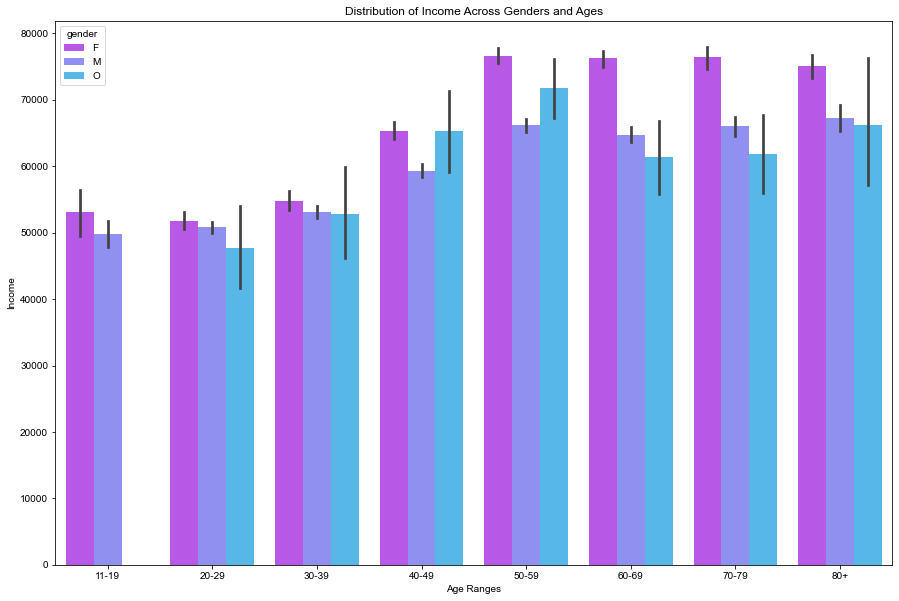

In [106]:
plt.figure(figsize=(15,10))
sb.barplot(data = profile, x = 'age_range', y = 'income', hue = 'gender', palette='cool_r')
plt.title('Distribution of Income Across Genders and Ages')
plt.xlabel('Age Ranges')
plt.ylabel('Income')
plt.style.use('seaborn')

## Analysis of gender across our customer data

In [107]:
portfolio

,reward,difficulty,duration,offer_id,offer_bogo,offer_discount,offer_informational,channel_email,channel_mobile,channel_social,channel_web
0,10,10,7,ae264e3637204a6fb9bb56bc8210ddfd,1,0,0,1,1,1,0
1,10,10,5,4d5c57ea9a6940dd891ad53e9dbe8da0,1,0,0,1,1,1,1
2,0,0,4,3f207df678b143eea3cee63160fa8bed,0,0,1,1,1,0,1
3,5,5,7,9b98b8c7a33c4b65b9aebfe6a799e6d9,1,0,0,1,1,0,1
4,5,20,10,0b1e1539f2cc45b7b9fa7c272da2e1d7,0,1,0,1,0,0,1
5,3,7,7,2298d6c36e964ae4a3e7e9706d1fb8c2,0,1,0,1,1,1,1
6,2,10,10,fafdcd668e3743c1bb461111dcafc2a4,0,1,0,1,1,1,1
7,0,0,3,5a8bc65990b245e5a138643cd4eb9837,0,0,1,1,1,1,0
8,5,5,5,f19421c1d4aa40978ebb69ca19b0e20d,1,0,0,1,1,1,1
9,2,10,7,2906b810c7d4411798c6938adc9daaa5,0,1,0,1,1,0,1


In [108]:
profile

,gender,age,customer_id,became_member_on,income,days_as_member,age_range
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0,382,50-59
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0,449,70-79
5,M,68,e2127556f4f64592b11af22de27a7932,2018-04-26,70000.0,97,60-69
8,M,65,389bc3fa690240e798340f5a15918d5c,2018-02-09,53000.0,173,60-69
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,2017-11-11,51000.0,263,50-59
...,...,...,...,...,...,...,...
16995,F,45,6d5f3a774f3d4714ab0c092238f3a1d7,2018-06-04,54000.0,58,40-49
16996,M,61,2cb4f97358b841b9a9773a7aa05a9d77,2018-07-13,72000.0,19,60-69
16997,M,49,01d26f638c274aa0b965d24cefe3183f,2017-01-26,73000.0,552,40-49
16998,F,83,9dc1421481194dcd9400aec7c9ae6366,2016-03-07,50000.0,877,80+


In [109]:
customer_id_1 = '0610b486422d4921ae7d2bf64640c50b'
customer_attributes = profile[profile['customer_id'] == customer_id_1]
customer_attributes

,gender,age,customer_id,became_member_on,income,days_as_member,age_range
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0,382,50-59


In [110]:
age = customer_attributes['age'].values[0]
age

55

In [111]:
became_member_on = customer_attributes['became_member_on'].values[0]
became_member_on

datetime.date(2017, 7, 15)

In [112]:
gender = customer_attributes['gender'].values[0]
gender

'F'

In [113]:
income = customer_attributes['income'].values[0]
income

112000.0

In [114]:
days_as_member = customer_attributes['days_as_member'].values[0]
days_as_member

382

In [115]:
age_range = customer_attributes['age_range'].values[0]
age_range

'50-59'

In [116]:
customer_transactions = pd.DataFrame()
num_discounts = 0
num_bogos = 0

In [117]:
transcript_offer

,customer_id,offer_completed,offer_received,offer_viewed,days,offer_id
0,78afa995795e4d85b5d9ceeca43f5fef,0,1,0,0.00,9b98b8c7a33c4b65b9aebfe6a799e6d9
1,78afa995795e4d85b5d9ceeca43f5fef,0,0,1,0.25,9b98b8c7a33c4b65b9aebfe6a799e6d9
3,78afa995795e4d85b5d9ceeca43f5fef,1,0,0,5.50,9b98b8c7a33c4b65b9aebfe6a799e6d9
5,78afa995795e4d85b5d9ceeca43f5fef,0,1,0,7.00,5a8bc65990b245e5a138643cd4eb9837
6,78afa995795e4d85b5d9ceeca43f5fef,0,0,1,9.00,5a8bc65990b245e5a138643cd4eb9837
...,...,...,...,...,...,...
272757,9fcbff4f8d7241faa4ab8a9d19c8a812,0,0,1,21.00,3f207df678b143eea3cee63160fa8bed
272758,9fcbff4f8d7241faa4ab8a9d19c8a812,0,1,0,24.00,4d5c57ea9a6940dd891ad53e9dbe8da0
272759,9fcbff4f8d7241faa4ab8a9d19c8a812,0,0,1,24.00,4d5c57ea9a6940dd891ad53e9dbe8da0
272760,3045af4e98794a04a5542d3eac939b1f,0,1,0,24.00,4d5c57ea9a6940dd891ad53e9dbe8da0


In [118]:
transcript_offer[transcript_offer['customer_id'] == customer_id_1]

,customer_id,offer_completed,offer_received,offer_viewed,days,offer_id
217357,0610b486422d4921ae7d2bf64640c50b,0,1,0,17.0,9b98b8c7a33c4b65b9aebfe6a799e6d9
217358,0610b486422d4921ae7d2bf64640c50b,0,1,0,21.0,3f207df678b143eea3cee63160fa8bed
217360,0610b486422d4921ae7d2bf64640c50b,1,0,0,22.0,9b98b8c7a33c4b65b9aebfe6a799e6d9


In [119]:
total_viewed = transcript_offer[transcript_offer['customer_id'] == customer_id_1]['offer_viewed'].sum()
total_viewed

0

In [120]:
total_received = transcript_offer[transcript_offer['customer_id'] == customer_id_1]['offer_received'].sum()
total_received

2

In [121]:
total_completed = transcript_offer[transcript_offer['customer_id'] == customer_id_1]['offer_completed'].sum()
total_completed

1

In [122]:
total_spent = transcript_amount[transcript_amount['customer_id'] == customer_id_1]['amount'].sum()
total_spent

77.01

In [123]:
avg_spent = transcript_amount[transcript_amount['customer_id'] == customer_id_1]['amount'].mean()
avg_spent

25.67

In [124]:
num_transactions = transcript_amount[transcript_amount['customer_id'] == customer_id_1]['transaction'].sum()
num_transactions

3

In [125]:
if total_viewed > 0:
    percent_completed = total_completed / total_received
else:
    percent_completed = 0

In [126]:
offer_completed_df = transcript_offer[transcript_offer['customer_id'] == customer_id_1]
offer_completed_df

,customer_id,offer_completed,offer_received,offer_viewed,days,offer_id
217357,0610b486422d4921ae7d2bf64640c50b,0,1,0,17.0,9b98b8c7a33c4b65b9aebfe6a799e6d9
217358,0610b486422d4921ae7d2bf64640c50b,0,1,0,21.0,3f207df678b143eea3cee63160fa8bed
217360,0610b486422d4921ae7d2bf64640c50b,1,0,0,22.0,9b98b8c7a33c4b65b9aebfe6a799e6d9


In [127]:
completed_offer_list = offer_completed_df['offer_id'].tolist()
completed_offer_list

['9b98b8c7a33c4b65b9aebfe6a799e6d9',
 '3f207df678b143eea3cee63160fa8bed',
 '9b98b8c7a33c4b65b9aebfe6a799e6d9']

In [128]:
completed_bogo = portfolio[portfolio['offer_id'].isin(completed_offer_list)]['offer_bogo'].sum()
completed_bogo

1

In [129]:
portfolio[portfolio['offer_id'].isin(completed_offer_list)]

,reward,difficulty,duration,offer_id,offer_bogo,offer_discount,offer_informational,channel_email,channel_mobile,channel_social,channel_web
2,0,0,4,3f207df678b143eea3cee63160fa8bed,0,0,1,1,1,0,1
3,5,5,7,9b98b8c7a33c4b65b9aebfe6a799e6d9,1,0,0,1,1,0,1


In [130]:
completed_discount = portfolio[portfolio['offer_id'].isin(completed_offer_list)]['offer_discount'].sum()
completed_discount

0

In [131]:
offers_received = transcript_offer[transcript_offer['customer_id'] == customer_id_1]['offer_id'].values.tolist()
offers_received

['9b98b8c7a33c4b65b9aebfe6a799e6d9',
 '3f207df678b143eea3cee63160fa8bed',
 '9b98b8c7a33c4b65b9aebfe6a799e6d9']

In [132]:
for x in offers_received:
    #Iterating through all the bogo offers
    if x in ['ae264e3637204a6fb9bb56bc8210ddfd', '4d5c57ea9a6940dd891ad53e9dbe8da0', '9b98b8c7a33c4b65b9aebfe6a799e6d9', 'f19421c1d4aa40978ebb69ca19b0e20d']:
        num_bogos += 1
    #Iterating through all the discount offers
    elif x in ['0b1e1539f2cc45b7b9fa7c272da2e1d7', '2298d6c36e964ae4a3e7e9706d1fb8c2', 'fafdcd668e3743c1bb461111dcafc2a4', '2906b810c7d4411798c6938adc9daaa5']:
        num_discounts += 1

In [133]:
num_bogos

2

In [134]:
num_discounts

0

In [135]:
if num_bogos > 0:
    bogo_percent_completed = completed_bogo / num_bogos
else:
    bogo_perecent_completed = 0.0

In [136]:
if num_discounts > 0:
    discount_percent_completed = completed_discount / num_discounts
else:
    discount_percent_completed = 0.0

In [137]:
person_entry_temp = {'customer_id': customer_id_1,
                        'age': age,
                        'age_range': age_range,
                        'gender': gender,
                        'income': income,
                        'became_member_on': became_member_on,
                        'days_as_member': days_as_member,
                        'total_completed': total_completed,
                        'total_viewed': total_viewed,
                        'total_received': total_received,
                        'percent_completed': percent_completed,
                        'total_spent': total_spent,
                        'avg_spent': avg_spent,
                        'num_transactions': num_transactions,
                        'completed_bogo': completed_bogo,
                        'num_bogos': num_bogos,
                        'bogo_percent_completed': bogo_percent_completed,
                        'completed_discount': completed_discount,
                        'num_discounts': num_discounts,
                        'discount_percent_completed': discount_percent_completed}

In [138]:
person_entry_temp

{'customer_id': '0610b486422d4921ae7d2bf64640c50b',
 'age': 55,
 'age_range': '50-59',
 'gender': 'F',
 'income': 112000.0,
 'became_member_on': datetime.date(2017, 7, 15),
 'days_as_member': 382,
 'total_completed': 1,
 'total_viewed': 0,
 'total_received': 2,
 'percent_completed': 0,
 'total_spent': 77.01,
 'avg_spent': 25.67,
 'num_transactions': 3,
 'completed_bogo': 1,
 'num_bogos': 2,
 'bogo_percent_completed': 0.5,
 'completed_discount': 0,
 'num_discounts': 0,
 'discount_percent_completed': 0.0}

In [139]:
portfolio

,reward,difficulty,duration,offer_id,offer_bogo,offer_discount,offer_informational,channel_email,channel_mobile,channel_social,channel_web
0,10,10,7,ae264e3637204a6fb9bb56bc8210ddfd,1,0,0,1,1,1,0
1,10,10,5,4d5c57ea9a6940dd891ad53e9dbe8da0,1,0,0,1,1,1,1
2,0,0,4,3f207df678b143eea3cee63160fa8bed,0,0,1,1,1,0,1
3,5,5,7,9b98b8c7a33c4b65b9aebfe6a799e6d9,1,0,0,1,1,0,1
4,5,20,10,0b1e1539f2cc45b7b9fa7c272da2e1d7,0,1,0,1,0,0,1
5,3,7,7,2298d6c36e964ae4a3e7e9706d1fb8c2,0,1,0,1,1,1,1
6,2,10,10,fafdcd668e3743c1bb461111dcafc2a4,0,1,0,1,1,1,1
7,0,0,3,5a8bc65990b245e5a138643cd4eb9837,0,0,1,1,1,1,0
8,5,5,5,f19421c1d4aa40978ebb69ca19b0e20d,1,0,0,1,1,1,1
9,2,10,7,2906b810c7d4411798c6938adc9daaa5,0,1,0,1,1,0,1


In [140]:
'''

#Creating a function that will build our master DataFrame_customer transactions
#Special thanks to this post for assisting how to append DataFrames: https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.append.html

def generate_transactions(customer_ids, portfolio = portfolio, profile = profile, transcript_offer = transcript_offer, transcript_amount = transcript_amount):
    
    #Initializing a list to append our individual customer dictionaries to
    person_entries = []
    
    for customer_id in customer_ids:
        #Pulling customer attributes from the 'profile' DataFrame
        customer_attributes = profile[profile['customer_id'] == customer_id]
        age = customer_attributes['age'].values[0]
        became_member_on = customer_attributes['became_member_on'].values[0]
        gender = customer_attributes['gender'].values[0]
        income = customer_attributes['income'].values[0]
        days_as_member = customer_attributes['days_as_member'].values[0]
        age_range = customer_attributes['age_range'].values[0]

        #Initializing variables we will use later on down
        customer_transactions = pd.DataFrame()
        num_discounts = 0
        num_bogos = 0

        #Establishing new features from respective transcript_offer and transcript_amount DataFrames
        total_viewed = transcript_offer[transcript_offer['customer_id'] == customer_id]['offer_viewed'].sum()
        total_received = transcript_offer[transcript_offer['customer_id'] == customer_id]['offer_received'].sum()
        total_completed = transcript_offer[transcript_offer['customer_id'] == customer_id]['offer_completed'].sum()
        total_spent = transcript_amount[transcript_amount['customer_id'] == customer_id]['amount'].sum()
        avg_spent = transcript_amount[transcript_amount['customer_id'] == customer_id]['amount'].mean()
        num_transactions = transcript_amount[transcript_amount['customer_id'] == customer_id]['transaction'].sum()

        #Determining percentage of completed bogo and discount offers
        if total_viewed > 0:
            percent_completed = total_completed / total_received
        else:
            percent_completed = 0

        #Determining the completed offers in order to determine the completed bogos and completed discounts
        offer_completed_df = transcript_offer[transcript_offer['customer_id'] == customer_id]
        completed_offer_list = offer_completed_df['offer_id'].tolist()
        completed_bogo = portfolio[portfolio['offer_id'].isin(completed_offer_list)]['offer_bogo'].sum()
        completed_discount = portfolio[portfolio['offer_id'].isin(completed_offer_list)]['offer_discount'].sum()

        #Determining all the offers received by an individual customer
        offers_received = transcript_offer[transcript_offer['customer_id'] == customer_id]['offer_id'].values.tolist()

        #Determining whether or not offer is a bogo or discount offer and incrementing appropriate variables
        for x in offers_received:
            #Iterating through all the bogo offers
            if x in ['ae264e3637204a6fb9bb56bc8210ddfd', '4d5c57ea9a6940dd891ad53e9dbe8da0', '9b98b8c7a33c4b65b9aebfe6a799e6d9', 'f19421c1d4aa40978ebb69ca19b0e20d']:
                num_bogos += 1
            #Iterating through all the discount offers
            elif x in ['0b1e1539f2cc45b7b9fa7c272da2e1d7', '2298d6c36e964ae4a3e7e9706d1fb8c2', 'fafdcd668e3743c1bb461111dcafc2a4', '2906b810c7d4411798c6938adc9daaa5']:
                num_discounts += 1

        #Determining the percentage of bogo & discount offers actually completed versus how many of each were offered
        if num_bogos > 0:
            bogo_percent_completed = completed_bogo / num_bogos
        else:
            bogo_perecent_completed = 0.0

        if num_discounts > 0:
            discount_percent_completed = completed_discount / num_discounts
        else:
            discount_percent_completed = 0.0

        #Adding all features to a unified dictionary, 'person_entry'
        person_entry = {'customer_id': customer_id,
                        'age': age,
                        'age_range': age_range,
                        'gender': gender,
                        'income': income,
                        'became_member_on': became_member_on,
                        'days_as_member': days_as_member,
                        'total_completed': total_completed,
                        'total_viewed': total_viewed,
                        'total_received': total_received,
                        'percent_completed': percent_completed,
                        'total_spent': total_spent,
                        'avg_spent': avg_spent,
                        'num_transactions': num_transactions,
                        'completed_bogo': completed_bogo,
                        'num_bogos': num_bogos,
                        'bogo_percent_completed': bogo_percent_completed,
                        'completed_discount': completed_discount,
                        'num_discounts': num_discounts,
                        'discount_percent_completed': discount_percent_completed}

        #Appending person_entry to master customer_transactions DataFrame
        person_entries.append(person_entry)
    
    #Building our final DataFrame from the person_entries list
    customer_transactions = pd.DataFrame(person_entries)
    
    return customer_transactions 
    
'''

"\n\n#Creating a function that will build our master DataFrame_customer transactions\n#Special thanks to this post for assisting how to append DataFrames: https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.append.html\n\ndef generate_transactions(customer_ids, portfolio = portfolio, profile = profile, transcript_offer = transcript_offer, transcript_amount = transcript_amount):\n    \n    #Initializing a list to append our individual customer dictionaries to\n    person_entries = []\n    \n    for customer_id in customer_ids:\n        #Pulling customer attributes from the 'profile' DataFrame\n        customer_attributes = profile[profile['customer_id'] == customer_id]\n        age = customer_attributes['age'].values[0]\n        became_member_on = customer_attributes['became_member_on'].values[0]\n        gender = customer_attributes['gender'].values[0]\n        income = customer_attributes['income'].values[0]\n        days_as_member = customer_attributes['days_a

In [141]:
#Generating a list of customer ids to iterate through
''' 
customer_ids = profile['customer_id'].to_list()

#Iterate through customer IDs to form master customer_transactions DataFrame
customer_transactions = generate_transactions(customer_ids)
customer_transactions.head()

'''

" \ncustomer_ids = profile['customer_id'].to_list()\n\n#Iterate through customer IDs to form master customer_transactions DataFrame\ncustomer_transactions = generate_transactions(customer_ids)\ncustomer_transactions.head()\n\n"

In [142]:
# customer_transactions.to_csv('customer_transactions.csv', index = False)

In [143]:
# customer_transactions

In [144]:
customer_transactions = pd.read_csv('customer_transactions.csv')

In [236]:
customer_transactions['Label'] = df_cluster['labels']

In [237]:
customer_transactions

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,Label
0,55,1,112000.0,382,1,0,2,0.000000,77.01,25.670000,3,1,2,0.500000,0,0,0.000000,-1
1,75,1,100000.0,449,3,4,4,0.750000,159.27,22.752857,7,3,9,0.333333,0,0,0.000000,-1
2,68,0,70000.0,97,2,3,4,0.500000,57.73,19.243333,3,1,3,0.333333,2,5,0.400000,3
3,65,0,53000.0,173,5,6,6,0.833333,36.43,12.143333,3,2,11,0.181818,2,6,0.333333,-1
4,58,0,51000.0,263,1,2,3,0.333333,15.62,3.905000,4,0,0,0.181818,2,5,0.400000,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,45,1,54000.0,58,0,3,3,0.000000,20.03,2.861429,7,1,2,0.500000,1,2,0.500000,0
14821,61,0,72000.0,19,1,1,3,0.333333,25.97,3.710000,7,1,2,0.500000,0,0,0.000000,-1
14822,49,0,73000.0,552,0,1,3,0.000000,39.74,4.967500,8,0,0,0.500000,1,1,1.000000,-1
14823,83,1,50000.0,877,3,3,3,1.000000,189.67,13.547857,14,3,9,0.333333,0,0,0.000000,-1


In [238]:
customer_transactions.to_csv('./Dashboard/customer_transactions.csv')

In [231]:
customer_transactions.rename(columns={'index':'labels'})

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,Label
0,55,1,112000.0,382,1,0,2,0.000000,77.01,25.670000,3,1,2,0.500000,0,0,0.000000,-1
1,75,1,100000.0,449,3,4,4,0.750000,159.27,22.752857,7,3,9,0.333333,0,0,0.000000,-1
2,68,0,70000.0,97,2,3,4,0.500000,57.73,19.243333,3,1,3,0.333333,2,5,0.400000,3
3,65,0,53000.0,173,5,6,6,0.833333,36.43,12.143333,3,2,11,0.181818,2,6,0.333333,-1
4,58,0,51000.0,263,1,2,3,0.333333,15.62,3.905000,4,0,0,0.181818,2,5,0.400000,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,45,1,54000.0,58,0,3,3,0.000000,20.03,2.861429,7,1,2,0.500000,1,2,0.500000,0
14821,61,0,72000.0,19,1,1,3,0.333333,25.97,3.710000,7,1,2,0.500000,0,0,0.000000,-1
14822,49,0,73000.0,552,0,1,3,0.000000,39.74,4.967500,8,0,0,0.500000,1,1,1.000000,-1
14823,83,1,50000.0,877,3,3,3,1.000000,189.67,13.547857,14,3,9,0.333333,0,0,0.000000,-1


In [232]:
customer_transactions

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,Label
0,55,1,112000.0,382,1,0,2,0.000000,77.01,25.670000,3,1,2,0.500000,0,0,0.000000,-1
1,75,1,100000.0,449,3,4,4,0.750000,159.27,22.752857,7,3,9,0.333333,0,0,0.000000,-1
2,68,0,70000.0,97,2,3,4,0.500000,57.73,19.243333,3,1,3,0.333333,2,5,0.400000,3
3,65,0,53000.0,173,5,6,6,0.833333,36.43,12.143333,3,2,11,0.181818,2,6,0.333333,-1
4,58,0,51000.0,263,1,2,3,0.333333,15.62,3.905000,4,0,0,0.181818,2,5,0.400000,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,45,1,54000.0,58,0,3,3,0.000000,20.03,2.861429,7,1,2,0.500000,1,2,0.500000,0
14821,61,0,72000.0,19,1,1,3,0.333333,25.97,3.710000,7,1,2,0.500000,0,0,0.000000,-1
14822,49,0,73000.0,552,0,1,3,0.000000,39.74,4.967500,8,0,0,0.500000,1,1,1.000000,-1
14823,83,1,50000.0,877,3,3,3,1.000000,189.67,13.547857,14,3,9,0.333333,0,0,0.000000,-1


In [233]:
labels = list(df_cluster['labels'])

In [234]:
labels = pd.DataFrame(labels)
labels.rename(columns={0:'labels'}, inplace=True)
labels

,labels
0,-1
1,-1
2,3
3,-1
4,2
...,...
14820,0
14821,-1
14822,-1
14823,-1


In [235]:
cols_to_drop = ['customer_id', 'became_member_on', 'age_range']
customer_transactions.drop(columns = cols_to_drop, inplace = True)
customer_transactions

KeyError: "['customer_id' 'became_member_on' 'age_range'] not found in axis"

In [153]:
gender_dict = {'M': 0, 'F': 1, 'O': 2}
customer_transactions['gender'].replace(gender_dict, inplace = True)
customer_transactions

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed
0,55,1,112000.0,382,1,0,2,0.000000,77.01,25.670000,3,1,2,0.500000,0,0,0.000000
1,75,1,100000.0,449,3,4,4,0.750000,159.27,22.752857,7,3,9,0.333333,0,0,0.000000
2,68,0,70000.0,97,2,3,4,0.500000,57.73,19.243333,3,1,3,0.333333,2,5,0.400000
3,65,0,53000.0,173,5,6,6,0.833333,36.43,12.143333,3,2,11,0.181818,2,6,0.333333
4,58,0,51000.0,263,1,2,3,0.333333,15.62,3.905000,4,0,0,0.181818,2,5,0.400000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,45,1,54000.0,58,0,3,3,0.000000,20.03,2.861429,7,1,2,0.500000,1,2,0.500000
14821,61,0,72000.0,19,1,1,3,0.333333,25.97,3.710000,7,1,2,0.500000,0,0,0.000000
14822,49,0,73000.0,552,0,1,3,0.000000,39.74,4.967500,8,0,0,0.500000,1,1,1.000000
14823,83,1,50000.0,877,3,3,3,1.000000,189.67,13.547857,14,3,9,0.333333,0,0,0.000000


In [154]:
customer_transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14825 entries, 0 to 14824
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   age                         14825 non-null  int64  
 1   gender                      14825 non-null  int64  
 2   income                      14825 non-null  float64
 3   days_as_member              14825 non-null  int64  
 4   total_completed             14825 non-null  int64  
 5   total_viewed                14825 non-null  int64  
 6   total_received              14825 non-null  int64  
 7   percent_completed           14825 non-null  float64
 8   total_spent                 14825 non-null  float64
 9   avg_spent                   14492 non-null  float64
 10  num_transactions            14825 non-null  int64  
 11  completed_bogo              14825 non-null  int64  
 12  num_bogos                   14825 non-null  int64  
 13  bogo_percent_completed      148

In [155]:
#Filling in avg_amount null values with Imputer
imputer = SimpleImputer(strategy = 'median')
cust_trans_imputed = pd.DataFrame(imputer.fit_transform(customer_transactions))
cust_trans_imputed

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,55.0,1.0,112000.0,382.0,1.0,0.0,2.0,0.000000,77.01,25.670000,3.0,1.0,2.0,0.500000,0.0,0.0,0.000000
1,75.0,1.0,100000.0,449.0,3.0,4.0,4.0,0.750000,159.27,22.752857,7.0,3.0,9.0,0.333333,0.0,0.0,0.000000
2,68.0,0.0,70000.0,97.0,2.0,3.0,4.0,0.500000,57.73,19.243333,3.0,1.0,3.0,0.333333,2.0,5.0,0.400000
3,65.0,0.0,53000.0,173.0,5.0,6.0,6.0,0.833333,36.43,12.143333,3.0,2.0,11.0,0.181818,2.0,6.0,0.333333
4,58.0,0.0,51000.0,263.0,1.0,2.0,3.0,0.333333,15.62,3.905000,4.0,0.0,0.0,0.181818,2.0,5.0,0.400000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,45.0,1.0,54000.0,58.0,0.0,3.0,3.0,0.000000,20.03,2.861429,7.0,1.0,2.0,0.500000,1.0,2.0,0.500000
14821,61.0,0.0,72000.0,19.0,1.0,1.0,3.0,0.333333,25.97,3.710000,7.0,1.0,2.0,0.500000,0.0,0.0,0.000000
14822,49.0,0.0,73000.0,552.0,0.0,1.0,3.0,0.000000,39.74,4.967500,8.0,0.0,0.0,0.500000,1.0,1.0,1.000000
14823,83.0,1.0,50000.0,877.0,3.0,3.0,3.0,1.000000,189.67,13.547857,14.0,3.0,9.0,0.333333,0.0,0.0,0.000000


In [156]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(cust_trans_imputed)
scaled_data

array([[ 0.03488876,  1.06355702,  2.15741893, ..., -1.71127424,
        -1.45171604, -1.58581046],
       [ 1.18543027,  1.06355702,  1.60180089, ..., -1.71127424,
        -1.45171604, -1.58581046],
       [ 0.78274074, -0.84253979,  0.2127558 , ...,  0.58264869,
         0.2752415 ,  0.12791777],
       ...,
       [-0.31027369, -0.84253979,  0.35166031, ..., -0.56431278,
        -1.10632453,  2.69851011],
       [ 1.64564687,  1.06355702, -0.71327427, ..., -1.71127424,
        -1.45171604, -1.58581046],
       [ 0.43757829,  1.06355702,  0.76837384, ..., -0.56431278,
        -0.41554151, -0.1577036 ]])

In [157]:
customer_transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14825 entries, 0 to 14824
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   age                         14825 non-null  int64  
 1   gender                      14825 non-null  int64  
 2   income                      14825 non-null  float64
 3   days_as_member              14825 non-null  int64  
 4   total_completed             14825 non-null  int64  
 5   total_viewed                14825 non-null  int64  
 6   total_received              14825 non-null  int64  
 7   percent_completed           14825 non-null  float64
 8   total_spent                 14825 non-null  float64
 9   avg_spent                   14492 non-null  float64
 10  num_transactions            14825 non-null  int64  
 11  completed_bogo              14825 non-null  int64  
 12  num_bogos                   14825 non-null  int64  
 13  bogo_percent_completed      148

In [158]:
column_names = customer_transactions.columns.values.tolist()
customer_transactions_master = pd.DataFrame(scaled_data, columns = column_names)
customer_transactions_master.head()

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed
0,0.034889,1.063557,2.157419,-0.349433,-0.751176,-2.604592,-2.313047,-1.459474,-0.307925,0.638206,-1.034512,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810
1,1.185430,1.063557,1.601801,-0.189601,0.512935,0.493128,-0.451989,0.797646,0.325036,0.459859,-0.262682,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810
2,0.782741,-0.842540,0.212756,-1.029314,-0.119121,-0.281302,-0.451989,0.045273,-0.456278,0.245295,-1.034512,-0.564000,-0.452891,-0.378410,0.582649,0.275242,0.127918
3,0.610160,-0.842540,-0.574370,-0.848012,1.777046,2.041988,1.409069,1.048437,-0.620174,-0.188782,-1.034512,0.591354,2.321675,-1.333996,0.582649,0.620633,-0.157704
4,0.207470,-0.842540,-0.666973,-0.633313,-0.751176,-1.055732,-1.382518,-0.456309,-0.780299,-0.692454,-0.841554,-1.719354,-1.493353,-1.333996,0.582649,0.275242,0.127918


In [159]:
customer_transactions_master.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14825 entries, 0 to 14824
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   age                         14825 non-null  float64
 1   gender                      14825 non-null  float64
 2   income                      14825 non-null  float64
 3   days_as_member              14825 non-null  float64
 4   total_completed             14825 non-null  float64
 5   total_viewed                14825 non-null  float64
 6   total_received              14825 non-null  float64
 7   percent_completed           14825 non-null  float64
 8   total_spent                 14825 non-null  float64
 9   avg_spent                   14825 non-null  float64
 10  num_transactions            14825 non-null  float64
 11  completed_bogo              14825 non-null  float64
 12  num_bogos                   14825 non-null  float64
 13  bogo_percent_completed      148

In [160]:
customer_transactions_master.to_csv('customer_transactions_scaled.csv', index = False)

In [161]:
#Using the single_link_model, we'll append the results as a new column to our master
customer_transactions_master_1 = customer_transactions_master
single_link_model = AgglomerativeClustering(n_clusters = 6, linkage = 'single')
customer_transactions_master_1['single_link_cluster'] = single_link_model.fit_predict(customer_transactions_master)
customer_transactions_master_1

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,single_link_cluster
0,0.034889,1.063557,2.157419,-0.349433,-0.751176,-2.604592,-2.313047,-1.459474,-0.307925,0.638206,-1.034512,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0
1,1.185430,1.063557,1.601801,-0.189601,0.512935,0.493128,-0.451989,0.797646,0.325036,0.459859,-0.262682,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0
2,0.782741,-0.842540,0.212756,-1.029314,-0.119121,-0.281302,-0.451989,0.045273,-0.456278,0.245295,-1.034512,-0.564000,-0.452891,-0.378410,0.582649,0.275242,0.127918,0
3,0.610160,-0.842540,-0.574370,-0.848012,1.777046,2.041988,1.409069,1.048437,-0.620174,-0.188782,-1.034512,0.591354,2.321675,-1.333996,0.582649,0.620633,-0.157704,0
4,0.207470,-0.842540,-0.666973,-0.633313,-0.751176,-1.055732,-1.382518,-0.456309,-0.780299,-0.692454,-0.841554,-1.719354,-1.493353,-1.333996,0.582649,0.275242,0.127918,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,-0.540382,1.063557,-0.528068,-1.122350,-1.383232,-0.281302,-1.382518,-1.459474,-0.746366,-0.756255,-0.262682,-0.564000,-0.799711,0.672734,-0.564313,-0.760933,0.556350,0
14821,0.380051,-0.842540,0.305359,-1.215386,-0.751176,-1.830162,-1.382518,-0.456309,-0.700660,-0.704375,-0.262682,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0
14822,-0.310274,-0.842540,0.351660,0.056110,-1.383232,-1.830162,-1.382518,-1.459474,-0.594704,-0.627495,-0.069725,-1.719354,-1.493353,0.672734,-0.564313,-1.106325,2.698510,0
14823,1.645647,1.063557,-0.713274,0.831413,0.512935,-0.281302,-1.382518,1.550019,0.558953,-0.102912,1.088019,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0


In [162]:
customer_transactions_master_1['single_link_cluster'].value_counts()

0    14820
4        1
5        1
3        1
2        1
1        1
Name: single_link_cluster, dtype: int64

## Number of Clusters using K-Means

In [163]:
customer_transactions_master

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,single_link_cluster
0,0.034889,1.063557,2.157419,-0.349433,-0.751176,-2.604592,-2.313047,-1.459474,-0.307925,0.638206,-1.034512,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0
1,1.185430,1.063557,1.601801,-0.189601,0.512935,0.493128,-0.451989,0.797646,0.325036,0.459859,-0.262682,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0
2,0.782741,-0.842540,0.212756,-1.029314,-0.119121,-0.281302,-0.451989,0.045273,-0.456278,0.245295,-1.034512,-0.564000,-0.452891,-0.378410,0.582649,0.275242,0.127918,0
3,0.610160,-0.842540,-0.574370,-0.848012,1.777046,2.041988,1.409069,1.048437,-0.620174,-0.188782,-1.034512,0.591354,2.321675,-1.333996,0.582649,0.620633,-0.157704,0
4,0.207470,-0.842540,-0.666973,-0.633313,-0.751176,-1.055732,-1.382518,-0.456309,-0.780299,-0.692454,-0.841554,-1.719354,-1.493353,-1.333996,0.582649,0.275242,0.127918,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,-0.540382,1.063557,-0.528068,-1.122350,-1.383232,-0.281302,-1.382518,-1.459474,-0.746366,-0.756255,-0.262682,-0.564000,-0.799711,0.672734,-0.564313,-0.760933,0.556350,0
14821,0.380051,-0.842540,0.305359,-1.215386,-0.751176,-1.830162,-1.382518,-0.456309,-0.700660,-0.704375,-0.262682,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0
14822,-0.310274,-0.842540,0.351660,0.056110,-1.383232,-1.830162,-1.382518,-1.459474,-0.594704,-0.627495,-0.069725,-1.719354,-1.493353,0.672734,-0.564313,-1.106325,2.698510,0
14823,1.645647,1.063557,-0.713274,0.831413,0.512935,-0.281302,-1.382518,1.550019,0.558953,-0.102912,1.088019,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0


In [164]:
#Building a function to quickly iterate through various KMeans models that takes in data and number of cluster as inputs
#Returns the appropriate k_means score
def kmeans_score(data, n_clusters):
    kmeans = KMeans(n_clusters = n_clusters)
    model = kmeans.fit(data)
    score = np.abs(model.score(data))
    return score

In [165]:
#Running the kmeans_score function for a number of different cluster patterns
scores = []
for i in range(1, 20):
    score = kmeans_score(customer_transactions_master, i)
    print("For n_clusters = ", i,"The K-Means Score is :", score)
    scores.append(score)

For n_clusters =  1 The K-Means Score is : 252079.98482293473
For n_clusters =  2 The K-Means Score is : 209679.00639261154
For n_clusters =  3 The K-Means Score is : 191840.46192101765
For n_clusters =  4 The K-Means Score is : 179779.26398753255
For n_clusters =  5 The K-Means Score is : 171092.86833485754
For n_clusters =  6 The K-Means Score is : 159451.4064882584
For n_clusters =  7 The K-Means Score is : 151427.17706466644
For n_clusters =  8 The K-Means Score is : 145594.75926368282
For n_clusters =  9 The K-Means Score is : 141183.35270686384
For n_clusters =  10 The K-Means Score is : 137638.1148802175
For n_clusters =  11 The K-Means Score is : 133910.039953014
For n_clusters =  12 The K-Means Score is : 130990.789918935
For n_clusters =  13 The K-Means Score is : 128110.00023658242
For n_clusters =  14 The K-Means Score is : 125976.02856560539
For n_clusters =  15 The K-Means Score is : 123830.79617089301
For n_clusters =  16 The K-Means Score is : 121972.07676155123
For n_c

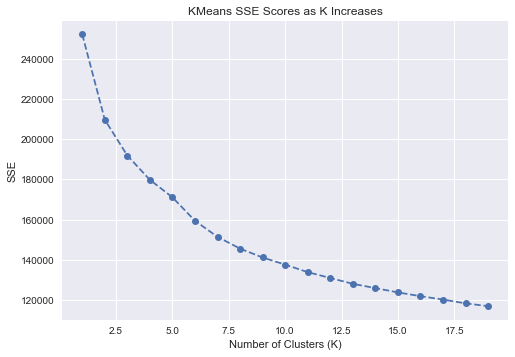

In [166]:
#Plotting results from the previous cell; noting that we begin seeing after about 6 clusters
centers = range(1, 20)
plt.plot(centers, scores, linestyle = '--', marker = 'o');
plt.style.use('seaborn');
plt.title('KMeans SSE Scores as K Increases');
plt.ylabel('SSE');
plt.xlabel('Number of Clusters (K)');

In [167]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=go.Scatter(x=list(centers), y=scores))
fig.update_layout(title='KMeans SSE Scores as K Increases',
                   xaxis_title='SSE',
                   yaxis_title='Number of Clusters (K)')
fig.show()

In [168]:
km = KMeans(n_clusters=5)
y_predicted = km.fit_predict(customer_transactions_master)
y_predicted

array([2, 0, 3, ..., 3, 0, 2])

In [169]:
customer_transactions_master_1['cluster_1']=y_predicted
customer_transactions_master_1.head()

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,single_link_cluster,cluster_1
0,0.034889,1.063557,2.157419,-0.349433,-0.751176,-2.604592,-2.313047,-1.459474,-0.307925,0.638206,-1.034512,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2
1,1.185430,1.063557,1.601801,-0.189601,0.512935,0.493128,-0.451989,0.797646,0.325036,0.459859,-0.262682,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0
2,0.782741,-0.842540,0.212756,-1.029314,-0.119121,-0.281302,-0.451989,0.045273,-0.456278,0.245295,-1.034512,-0.564000,-0.452891,-0.378410,0.582649,0.275242,0.127918,0,3
3,0.610160,-0.842540,-0.574370,-0.848012,1.777046,2.041988,1.409069,1.048437,-0.620174,-0.188782,-1.034512,0.591354,2.321675,-1.333996,0.582649,0.620633,-0.157704,0,0
4,0.207470,-0.842540,-0.666973,-0.633313,-0.751176,-1.055732,-1.382518,-0.456309,-0.780299,-0.692454,-0.841554,-1.719354,-1.493353,-1.333996,0.582649,0.275242,0.127918,0,3


In [170]:
km.cluster_centers_[0,0]

0.1496637479605832

In [171]:
customer_transactions_master_1.to_csv('./Dashboard/cust_tran_master_1.csv')

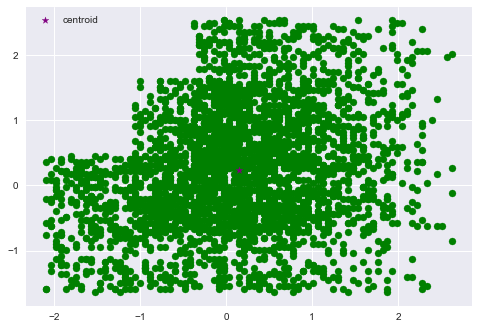

In [172]:
df1 = customer_transactions_master_1[customer_transactions_master_1.cluster_1==0]
df2 = customer_transactions_master_1[customer_transactions_master_1.cluster_1==1]
df3 = customer_transactions_master_1[customer_transactions_master_1.cluster_1==2]
df4 = customer_transactions_master_1[customer_transactions_master_1.cluster_1==3]
df5 = customer_transactions_master_1[customer_transactions_master_1.cluster_1==4]
plt.scatter(df1.age,df1['income'],color='green')
plt.scatter(km.cluster_centers_[0,0],km.cluster_centers_[0,1],color='purple',marker='*',label='centroid')
plt.legend()

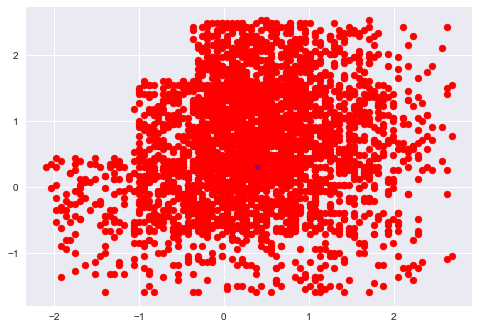

In [173]:
plt.scatter(df2.age,df2['income'],color='red')
plt.scatter(km.cluster_centers_[1,0],km.cluster_centers_[1,1],color='purple',marker='*',label='centroid')

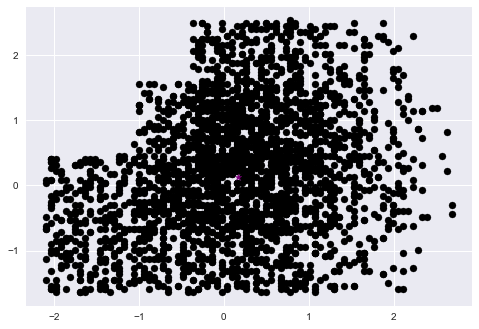

In [174]:
plt.scatter(df3.age,df3['income'],color='black')
plt.scatter(km.cluster_centers_[2,0],km.cluster_centers_[2,1],color='purple',marker='*',label='centroid')

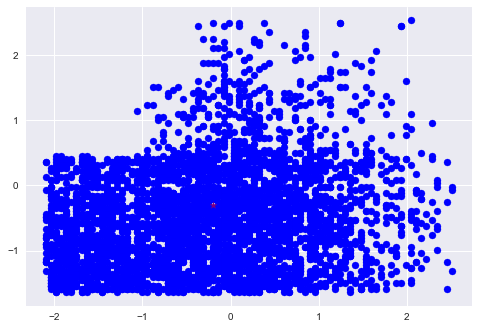

In [175]:
plt.scatter(df4.age,df4['income'],color='blue')
plt.scatter(km.cluster_centers_[3,0],km.cluster_centers_[3,1],color='purple',marker='*',label='centroid')

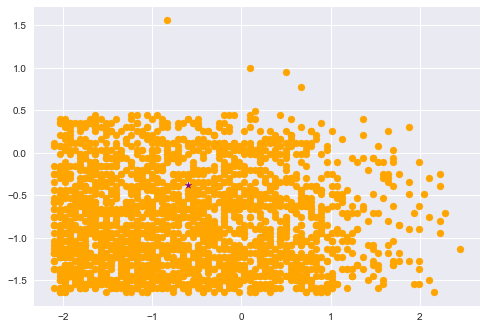

In [176]:
plt.scatter(df5.age,df5['income'],color='orange')
plt.scatter(km.cluster_centers_[4,0],km.cluster_centers_[4,1],color='purple',marker='*',label='centroid')

## Between Age and Gender

In [177]:
scores = []
for i in range(1, 20):
    score = kmeans_score(customer_transactions_master[['age', 'gender']], i)
    print("For n_clusters = ", i,"The K-Means Score is :", score)
    scores.append(score)

For n_clusters =  1 The K-Means Score is : 29649.99999999972
For n_clusters =  2 The K-Means Score is : 15229.201159782071
For n_clusters =  3 The K-Means Score is : 9289.477821826145
For n_clusters =  4 The K-Means Score is : 5728.610157823659
For n_clusters =  5 The K-Means Score is : 4270.248343793191
For n_clusters =  6 The K-Means Score is : 3050.8507091854544
For n_clusters =  7 The K-Means Score is : 2465.4495403721867
For n_clusters =  8 The K-Means Score is : 1934.3265744767973
For n_clusters =  9 The K-Means Score is : 1517.4310384730338
For n_clusters =  10 The K-Means Score is : 1239.2614134459723
For n_clusters =  11 The K-Means Score is : 1051.2848662226677
For n_clusters =  12 The K-Means Score is : 916.4064941196355
For n_clusters =  13 The K-Means Score is : 791.607456565377
For n_clusters =  14 The K-Means Score is : 676.7911116318669
For n_clusters =  15 The K-Means Score is : 603.9552096377283
For n_clusters =  16 The K-Means Score is : 526.3442617182708
For n_clust

In [178]:
value = range(1,20)
k_means_result_2 = pd.DataFrame(scores, value).reset_index()

In [179]:
k_means_result_2.rename(columns={'index':'Number_of_Clusters', 0:'K_Means_Score'}, inplace=True)

In [180]:
k_means_result_2.to_csv('./Dashboard/K_means_result_2.csv')

In [181]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=go.Scatter(x=list(centers), y=scores))
fig.update_layout(title='KMeans SSE Scores as K Increases',
                   xaxis_title='SSE',
                   yaxis_title='Number of Clusters (K)')
fig.show()

## Between Age and Income

In [182]:
customer_transactions_master

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,single_link_cluster,cluster_1
0,0.034889,1.063557,2.157419,-0.349433,-0.751176,-2.604592,-2.313047,-1.459474,-0.307925,0.638206,-1.034512,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2
1,1.185430,1.063557,1.601801,-0.189601,0.512935,0.493128,-0.451989,0.797646,0.325036,0.459859,-0.262682,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0
2,0.782741,-0.842540,0.212756,-1.029314,-0.119121,-0.281302,-0.451989,0.045273,-0.456278,0.245295,-1.034512,-0.564000,-0.452891,-0.378410,0.582649,0.275242,0.127918,0,3
3,0.610160,-0.842540,-0.574370,-0.848012,1.777046,2.041988,1.409069,1.048437,-0.620174,-0.188782,-1.034512,0.591354,2.321675,-1.333996,0.582649,0.620633,-0.157704,0,0
4,0.207470,-0.842540,-0.666973,-0.633313,-0.751176,-1.055732,-1.382518,-0.456309,-0.780299,-0.692454,-0.841554,-1.719354,-1.493353,-1.333996,0.582649,0.275242,0.127918,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,-0.540382,1.063557,-0.528068,-1.122350,-1.383232,-0.281302,-1.382518,-1.459474,-0.746366,-0.756255,-0.262682,-0.564000,-0.799711,0.672734,-0.564313,-0.760933,0.556350,0,3
14821,0.380051,-0.842540,0.305359,-1.215386,-0.751176,-1.830162,-1.382518,-0.456309,-0.700660,-0.704375,-0.262682,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2
14822,-0.310274,-0.842540,0.351660,0.056110,-1.383232,-1.830162,-1.382518,-1.459474,-0.594704,-0.627495,-0.069725,-1.719354,-1.493353,0.672734,-0.564313,-1.106325,2.698510,0,3
14823,1.645647,1.063557,-0.713274,0.831413,0.512935,-0.281302,-1.382518,1.550019,0.558953,-0.102912,1.088019,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0


In [183]:
scores = []
for i in range(1, 20):
    score = kmeans_score(customer_transactions_master[['age', 'income']], i)
    print("For n_clusters = ", i,"The K-Means Score is :", score)
    scores.append(score)

For n_clusters =  1 The K-Means Score is : 29650.00000000003
For n_clusters =  2 The K-Means Score is : 16451.79871700314
For n_clusters =  3 The K-Means Score is : 10690.375707393356
For n_clusters =  4 The K-Means Score is : 8554.243341977904
For n_clusters =  5 The K-Means Score is : 6829.306503196123
For n_clusters =  6 The K-Means Score is : 5846.67248297725
For n_clusters =  7 The K-Means Score is : 4990.06184605609
For n_clusters =  8 The K-Means Score is : 4392.3564206003275
For n_clusters =  9 The K-Means Score is : 3918.1866954161587
For n_clusters =  10 The K-Means Score is : 3537.733989352351
For n_clusters =  11 The K-Means Score is : 3175.496266934016
For n_clusters =  12 The K-Means Score is : 2897.7990728531913
For n_clusters =  13 The K-Means Score is : 2682.450288296281
For n_clusters =  14 The K-Means Score is : 2484.5370030310314
For n_clusters =  15 The K-Means Score is : 2308.231822326073
For n_clusters =  16 The K-Means Score is : 2157.949147310365
For n_clusters

In [184]:
value = range(1,20)
k_means_result_3 = pd.DataFrame(scores, value).reset_index()

In [185]:
k_means_result_3.rename(columns={'index':'Number_of_Clusters', 0:'K_Means_Score'}, inplace=True)

In [186]:
k_means_result_3.to_csv('./Dashboard/K_means_result_3.csv')

In [187]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=go.Scatter(x=list(centers), y=scores))
fig.update_layout(title='KMeans SSE Scores as K Increases',
                   xaxis_title='SSE',
                   yaxis_title='Number of Clusters (K)')
fig.show()

## Between Gender and Income

In [188]:
scores = []
for i in range(1, 20):
    score = kmeans_score(customer_transactions_master[['gender', 'income']], i)
    print("For n_clusters = ", i,"The K-Means Score is :", score)
    scores.append(score)

For n_clusters =  1 The K-Means Score is : 29650.000000000007
For n_clusters =  2 The K-Means Score is : 14815.659598844837
For n_clusters =  3 The K-Means Score is : 9412.398233481528
For n_clusters =  4 The K-Means Score is : 5305.104063717904
For n_clusters =  5 The K-Means Score is : 3978.696264009662
For n_clusters =  6 The K-Means Score is : 2812.7029620649023
For n_clusters =  7 The K-Means Score is : 2203.564151773057
For n_clusters =  8 The K-Means Score is : 1722.1843808868853
For n_clusters =  9 The K-Means Score is : 1323.1346185741656
For n_clusters =  10 The K-Means Score is : 1102.9284828451687
For n_clusters =  11 The K-Means Score is : 906.7759846829559
For n_clusters =  12 The K-Means Score is : 774.5123988357783
For n_clusters =  13 The K-Means Score is : 666.4094869297508
For n_clusters =  14 The K-Means Score is : 563.1597310159483
For n_clusters =  15 The K-Means Score is : 495.3668750316699
For n_clusters =  16 The K-Means Score is : 422.84349686886395
For n_clus

In [189]:
value = range(1,20)
k_means_result_4 = pd.DataFrame(scores, value).reset_index()

In [190]:
k_means_result_4.rename(columns={'index':'Number_of_Clusters', 0:'K_Means_Score'}, inplace=True)

In [191]:
k_means_result_4.to_csv('./Dashboard/K_means_result_4.csv')

In [192]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=go.Scatter(x=list(centers), y=scores))
fig.update_layout(title='KMeans SSE Scores as K Increases',
                   xaxis_title='SSE',
                   yaxis_title='Number of Clusters (K)')
fig.show()

In [193]:
km = KMeans(n_clusters=5)
y_predicted = km.fit_predict(customer_transactions_master[['gender', 'income']])
y_predicted

array([2, 2, 1, ..., 1, 0, 2])

In [194]:
customer_transactions_master_1['cluster_2']=y_predicted
customer_transactions_master_1.head()

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,single_link_cluster,cluster_1,cluster_2
0,0.034889,1.063557,2.157419,-0.349433,-0.751176,-2.604592,-2.313047,-1.459474,-0.307925,0.638206,-1.034512,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2,2
1,1.185430,1.063557,1.601801,-0.189601,0.512935,0.493128,-0.451989,0.797646,0.325036,0.459859,-0.262682,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0,2
2,0.782741,-0.842540,0.212756,-1.029314,-0.119121,-0.281302,-0.451989,0.045273,-0.456278,0.245295,-1.034512,-0.564000,-0.452891,-0.378410,0.582649,0.275242,0.127918,0,3,1
3,0.610160,-0.842540,-0.574370,-0.848012,1.777046,2.041988,1.409069,1.048437,-0.620174,-0.188782,-1.034512,0.591354,2.321675,-1.333996,0.582649,0.620633,-0.157704,0,0,3
4,0.207470,-0.842540,-0.666973,-0.633313,-0.751176,-1.055732,-1.382518,-0.456309,-0.780299,-0.692454,-0.841554,-1.719354,-1.493353,-1.333996,0.582649,0.275242,0.127918,0,3,3


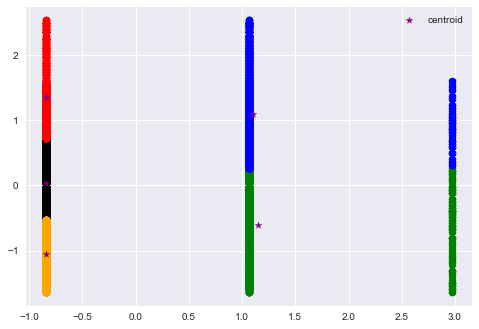

In [195]:
df1 = customer_transactions_master_1[customer_transactions_master_1.cluster_2==0]
df2 = customer_transactions_master_1[customer_transactions_master_1.cluster_2==1]
df3 = customer_transactions_master_1[customer_transactions_master_1.cluster_2==2]
df4 = customer_transactions_master_1[customer_transactions_master_1.cluster_2==3]
df5 = customer_transactions_master_1[customer_transactions_master_1.cluster_2==4]
plt.scatter(df1.gender,df1['income'],color='green')
plt.scatter(df2.gender,df2['income'],color='black')
plt.scatter(df3.gender,df3['income'],color='blue')
plt.scatter(df4.gender,df4['income'],color='orange')
plt.scatter(df5.gender,df5['income'],color='red')
plt.scatter(km.cluster_centers_[:,0],km.cluster_centers_[:,1],color='purple',marker='*',label='centroid')
plt.legend()

# DBSCAN

In [196]:
from sklearn.cluster import DBSCAN

In [197]:
dbscan =  DBSCAN(eps=35, min_samples=10)
labels = dbscan.fit_predict(customer_transactions_master[['age', 'gender']])

In [198]:
np.unique(labels)

array([0], dtype=int64)

In [199]:
customer_transactions_master

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,single_link_cluster,cluster_1,cluster_2
0,0.034889,1.063557,2.157419,-0.349433,-0.751176,-2.604592,-2.313047,-1.459474,-0.307925,0.638206,-1.034512,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2,2
1,1.185430,1.063557,1.601801,-0.189601,0.512935,0.493128,-0.451989,0.797646,0.325036,0.459859,-0.262682,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0,2
2,0.782741,-0.842540,0.212756,-1.029314,-0.119121,-0.281302,-0.451989,0.045273,-0.456278,0.245295,-1.034512,-0.564000,-0.452891,-0.378410,0.582649,0.275242,0.127918,0,3,1
3,0.610160,-0.842540,-0.574370,-0.848012,1.777046,2.041988,1.409069,1.048437,-0.620174,-0.188782,-1.034512,0.591354,2.321675,-1.333996,0.582649,0.620633,-0.157704,0,0,3
4,0.207470,-0.842540,-0.666973,-0.633313,-0.751176,-1.055732,-1.382518,-0.456309,-0.780299,-0.692454,-0.841554,-1.719354,-1.493353,-1.333996,0.582649,0.275242,0.127918,0,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,-0.540382,1.063557,-0.528068,-1.122350,-1.383232,-0.281302,-1.382518,-1.459474,-0.746366,-0.756255,-0.262682,-0.564000,-0.799711,0.672734,-0.564313,-0.760933,0.556350,0,3,0
14821,0.380051,-0.842540,0.305359,-1.215386,-0.751176,-1.830162,-1.382518,-0.456309,-0.700660,-0.704375,-0.262682,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2,1
14822,-0.310274,-0.842540,0.351660,0.056110,-1.383232,-1.830162,-1.382518,-1.459474,-0.594704,-0.627495,-0.069725,-1.719354,-1.493353,0.672734,-0.564313,-1.106325,2.698510,0,3,1
14823,1.645647,1.063557,-0.713274,0.831413,0.512935,-0.281302,-1.382518,1.550019,0.558953,-0.102912,1.088019,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0,0


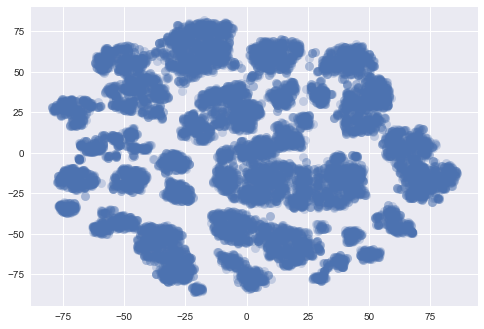

In [200]:
from sklearn.manifold import TSNE

plot_kwds = {'alpha' : 0.25, 's' : 80, 'linewidths':0}

projection = TSNE().fit_transform(customer_transactions_master)
plt.scatter(*projection.T, **plot_kwds)

In [201]:
projection

array([[-30.247562 , -18.131285 ],
       [ 42.659054 , -48.71703  ],
       [ -4.5841675,  25.917246 ],
       ...,
       [ 15.617593 ,  29.17983  ],
       [ 49.891388 , -60.313538 ],
       [  4.054264 ,   1.432387 ]], dtype=float32)

In [202]:
import hdbscan
import seaborn as sns

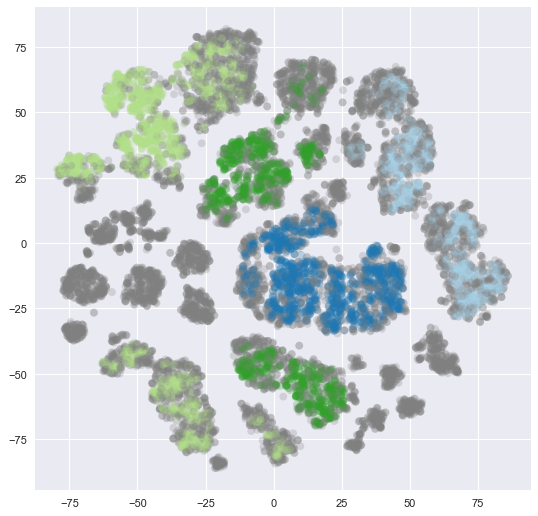

In [203]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=890, min_samples=10).fit(customer_transactions_master)

plt.figure(figsize=(8, 8), dpi=80)
color_palette = sns.color_palette('Paired', 12)
cluster_colors = [color_palette[x] if x >= 0
                  else (0.5, 0.5, 0.5)
                  for x in clusterer.labels_]
cluster_member_colors = [sns.desaturate(x, p) for x, p in
                         zip(cluster_colors, clusterer.probabilities_)]
plt.scatter(*projection.T, s=50, linewidth=0, c=cluster_member_colors, alpha=0.25)

In [204]:
len(cluster_member_colors)

14825

In [205]:
projection

array([[-30.247562 , -18.131285 ],
       [ 42.659054 , -48.71703  ],
       [ -4.5841675,  25.917246 ],
       ...,
       [ 15.617593 ,  29.17983  ],
       [ 49.891388 , -60.313538 ],
       [  4.054264 ,   1.432387 ]], dtype=float32)

In [206]:
np.unique(clusterer.labels_)

array([-1,  0,  1,  2,  3], dtype=int64)

In [207]:
clusterer.labels_.size

14825

In [208]:
import plotly.express as px
fig = px.scatter(*projection.T, color=clusterer.labels_)
fig.show()

[Text(0, 0, '-1'),
 Text(1, 0, '0'),
 Text(2, 0, '1'),
 Text(3, 0, '2'),
 Text(4, 0, '3')]

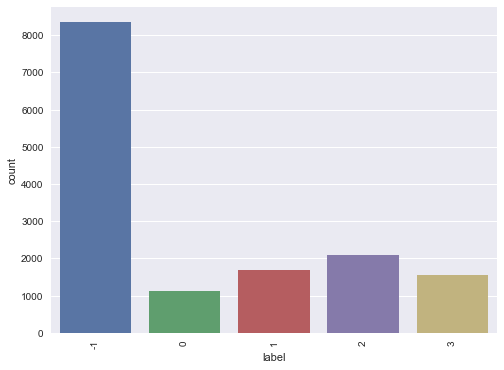

In [209]:
label_normal = clusterer.labels_
label_normal = pd.DataFrame({"label": clusterer.labels_})

plt.figure(figsize=(8, 6)) 
ax = sns.countplot(x='label', data=label_normal)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


In [210]:
label_normal

,label
0,-1
1,-1
2,3
3,-1
4,2
...,...
14820,0
14821,-1
14822,-1
14823,-1


In [211]:
label_normal = label_normal.groupby(by = ['label']).size().reset_index(name = 'count')

In [212]:
import plotly.express as px

fig = px.bar(label_normal, x='label', y='count',
             color='label',
             height=600)
fig.show()

In [213]:
# Save dataset with each cluster
df_cluster = customer_transactions_master.copy()
df_cluster['labels'] = clusterer.labels_
df_cluster

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,...,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,single_link_cluster,cluster_1,cluster_2,labels
0,0.034889,1.063557,2.157419,-0.349433,-0.751176,-2.604592,-2.313047,-1.459474,-0.307925,0.638206,...,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2,2,-1
1,1.185430,1.063557,1.601801,-0.189601,0.512935,0.493128,-0.451989,0.797646,0.325036,0.459859,...,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0,2,-1
2,0.782741,-0.842540,0.212756,-1.029314,-0.119121,-0.281302,-0.451989,0.045273,-0.456278,0.245295,...,-0.564000,-0.452891,-0.378410,0.582649,0.275242,0.127918,0,3,1,3
3,0.610160,-0.842540,-0.574370,-0.848012,1.777046,2.041988,1.409069,1.048437,-0.620174,-0.188782,...,0.591354,2.321675,-1.333996,0.582649,0.620633,-0.157704,0,0,3,-1
4,0.207470,-0.842540,-0.666973,-0.633313,-0.751176,-1.055732,-1.382518,-0.456309,-0.780299,-0.692454,...,-1.719354,-1.493353,-1.333996,0.582649,0.275242,0.127918,0,3,3,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,-0.540382,1.063557,-0.528068,-1.122350,-1.383232,-0.281302,-1.382518,-1.459474,-0.746366,-0.756255,...,-0.564000,-0.799711,0.672734,-0.564313,-0.760933,0.556350,0,3,0,0
14821,0.380051,-0.842540,0.305359,-1.215386,-0.751176,-1.830162,-1.382518,-0.456309,-0.700660,-0.704375,...,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2,1,-1
14822,-0.310274,-0.842540,0.351660,0.056110,-1.383232,-1.830162,-1.382518,-1.459474,-0.594704,-0.627495,...,-1.719354,-1.493353,0.672734,-0.564313,-1.106325,2.698510,0,3,1,-1
14823,1.645647,1.063557,-0.713274,0.831413,0.512935,-0.281302,-1.382518,1.550019,0.558953,-0.102912,...,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0,0,-1


In [214]:
profile

,gender,age,customer_id,became_member_on,income,days_as_member,age_range
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0,382,50-59
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0,449,70-79
5,M,68,e2127556f4f64592b11af22de27a7932,2018-04-26,70000.0,97,60-69
8,M,65,389bc3fa690240e798340f5a15918d5c,2018-02-09,53000.0,173,60-69
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,2017-11-11,51000.0,263,50-59
...,...,...,...,...,...,...,...
16995,F,45,6d5f3a774f3d4714ab0c092238f3a1d7,2018-06-04,54000.0,58,40-49
16996,M,61,2cb4f97358b841b9a9773a7aa05a9d77,2018-07-13,72000.0,19,60-69
16997,M,49,01d26f638c274aa0b965d24cefe3183f,2017-01-26,73000.0,552,40-49
16998,F,83,9dc1421481194dcd9400aec7c9ae6366,2016-03-07,50000.0,877,80+


In [215]:
df_cluster.to_csv('final_segmentation.csv')

In [216]:
df_cluster

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,...,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,single_link_cluster,cluster_1,cluster_2,labels
0,0.034889,1.063557,2.157419,-0.349433,-0.751176,-2.604592,-2.313047,-1.459474,-0.307925,0.638206,...,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2,2,-1
1,1.185430,1.063557,1.601801,-0.189601,0.512935,0.493128,-0.451989,0.797646,0.325036,0.459859,...,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0,2,-1
2,0.782741,-0.842540,0.212756,-1.029314,-0.119121,-0.281302,-0.451989,0.045273,-0.456278,0.245295,...,-0.564000,-0.452891,-0.378410,0.582649,0.275242,0.127918,0,3,1,3
3,0.610160,-0.842540,-0.574370,-0.848012,1.777046,2.041988,1.409069,1.048437,-0.620174,-0.188782,...,0.591354,2.321675,-1.333996,0.582649,0.620633,-0.157704,0,0,3,-1
4,0.207470,-0.842540,-0.666973,-0.633313,-0.751176,-1.055732,-1.382518,-0.456309,-0.780299,-0.692454,...,-1.719354,-1.493353,-1.333996,0.582649,0.275242,0.127918,0,3,3,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,-0.540382,1.063557,-0.528068,-1.122350,-1.383232,-0.281302,-1.382518,-1.459474,-0.746366,-0.756255,...,-0.564000,-0.799711,0.672734,-0.564313,-0.760933,0.556350,0,3,0,0
14821,0.380051,-0.842540,0.305359,-1.215386,-0.751176,-1.830162,-1.382518,-0.456309,-0.700660,-0.704375,...,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2,1,-1
14822,-0.310274,-0.842540,0.351660,0.056110,-1.383232,-1.830162,-1.382518,-1.459474,-0.594704,-0.627495,...,-1.719354,-1.493353,0.672734,-0.564313,-1.106325,2.698510,0,3,1,-1
14823,1.645647,1.063557,-0.713274,0.831413,0.512935,-0.281302,-1.382518,1.550019,0.558953,-0.102912,...,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0,0,-1


In [217]:
df_cluster = pd.read_csv('final_segmentation.csv')
df_cluster

,Unnamed: 0,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,...,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,single_link_cluster,cluster_1,cluster_2,labels
0,0,0.034889,1.063557,2.157419,-0.349433,-0.751176,-2.604592,-2.313047,-1.459474,-0.307925,...,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2,2,-1
1,1,1.185430,1.063557,1.601801,-0.189601,0.512935,0.493128,-0.451989,0.797646,0.325036,...,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0,2,-1
2,2,0.782741,-0.842540,0.212756,-1.029314,-0.119121,-0.281302,-0.451989,0.045273,-0.456278,...,-0.564000,-0.452891,-0.378410,0.582649,0.275242,0.127918,0,3,1,3
3,3,0.610160,-0.842540,-0.574370,-0.848012,1.777046,2.041988,1.409069,1.048437,-0.620174,...,0.591354,2.321675,-1.333996,0.582649,0.620633,-0.157704,0,0,3,-1
4,4,0.207470,-0.842540,-0.666973,-0.633313,-0.751176,-1.055732,-1.382518,-0.456309,-0.780299,...,-1.719354,-1.493353,-1.333996,0.582649,0.275242,0.127918,0,3,3,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,14820,-0.540382,1.063557,-0.528068,-1.122350,-1.383232,-0.281302,-1.382518,-1.459474,-0.746366,...,-0.564000,-0.799711,0.672734,-0.564313,-0.760933,0.556350,0,3,0,0
14821,14821,0.380051,-0.842540,0.305359,-1.215386,-0.751176,-1.830162,-1.382518,-0.456309,-0.700660,...,-0.564000,-0.799711,0.672734,-1.711274,-1.451716,-1.585810,0,2,1,-1
14822,14822,-0.310274,-0.842540,0.351660,0.056110,-1.383232,-1.830162,-1.382518,-1.459474,-0.594704,...,-1.719354,-1.493353,0.672734,-0.564313,-1.106325,2.698510,0,3,1,-1
14823,14823,1.645647,1.063557,-0.713274,0.831413,0.512935,-0.281302,-1.382518,1.550019,0.558953,...,1.746709,1.628034,-0.378410,-1.711274,-1.451716,-1.585810,0,0,0,-1


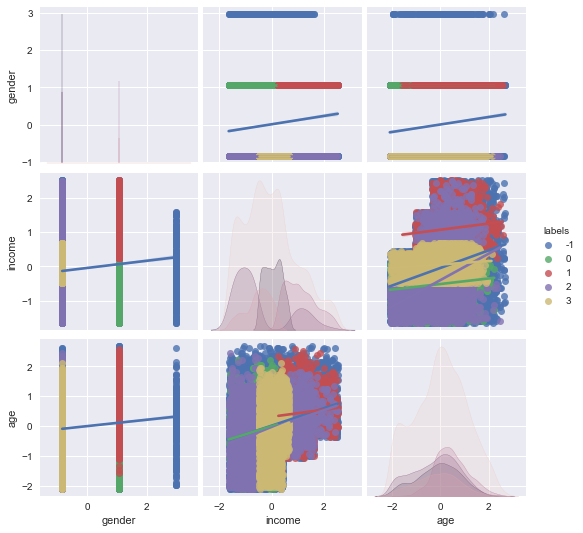

In [218]:
import seaborn as sns
personal_details = ['gender', 'income', 'age', 'labels']
sns.pairplot(df_cluster[personal_details], hue='labels', kind='reg');

ValueError: The palette list has the wrong number of colors.

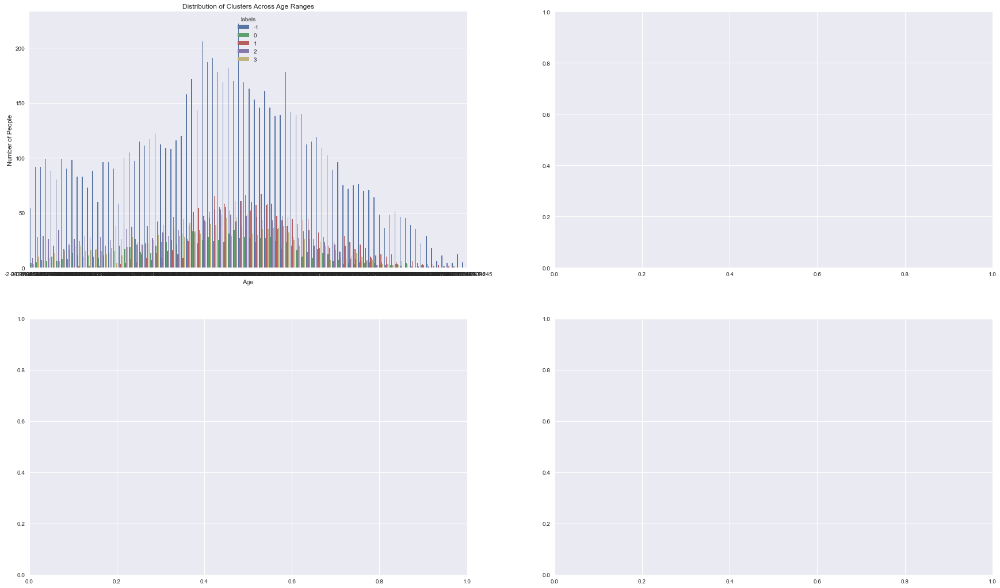

In [219]:
fig, axes = plt.subplots(nrows = 2, ncols = 2, figsize = (30, 18))

#Visualizing clusters across age ranges
sns.countplot(data = df_cluster, x = 'age', hue = 'labels', ax = axes[0,0]);
axes[0,0].set_title('Distribution of Clusters Across Age Ranges');
axes[0,0].set_xlabel('Age');
axes[0,0].set_ylabel('Number of People');

#Visualizing clusters across incomes and age ranges
sns.scatterplot(data = df_cluster, x = 'age', y = 'income', hue = 'labels', palette = sns.color_palette('muted', n_colors = 4), ax = axes[0,1]);
axes[0,1].set_title('Distribution of Clusters Across Income and Age');
axes[0,1].set_xlabel('Age');
axes[0,1].set_ylabel('Income');

#Visualizing clusters across age ranges
sns.countplot(data = df_cluster, x = 'gender', hue = 'labels', ax = axes[1,0]);
axes[1,0].set_title('Distribution of Clusters Across Genders');
axes[1,0].set_xlabel('Genders');
axes[1,0].set_ylabel('Number of People');
plt.sca(axes[1,0]);
plt.xticks(range(3), ['Male', 'Female', 'Other']);


In [220]:
customer_transactions

,age,gender,income,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed
0,55,1,112000.0,382,1,0,2,0.000000,77.01,25.670000,3,1,2,0.500000,0,0,0.000000
1,75,1,100000.0,449,3,4,4,0.750000,159.27,22.752857,7,3,9,0.333333,0,0,0.000000
2,68,0,70000.0,97,2,3,4,0.500000,57.73,19.243333,3,1,3,0.333333,2,5,0.400000
3,65,0,53000.0,173,5,6,6,0.833333,36.43,12.143333,3,2,11,0.181818,2,6,0.333333
4,58,0,51000.0,263,1,2,3,0.333333,15.62,3.905000,4,0,0,0.181818,2,5,0.400000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,45,1,54000.0,58,0,3,3,0.000000,20.03,2.861429,7,1,2,0.500000,1,2,0.500000
14821,61,0,72000.0,19,1,1,3,0.333333,25.97,3.710000,7,1,2,0.500000,0,0,0.000000
14822,49,0,73000.0,552,0,1,3,0.000000,39.74,4.967500,8,0,0,0.500000,1,1,1.000000
14823,83,1,50000.0,877,3,3,3,1.000000,189.67,13.547857,14,3,9,0.333333,0,0,0.000000


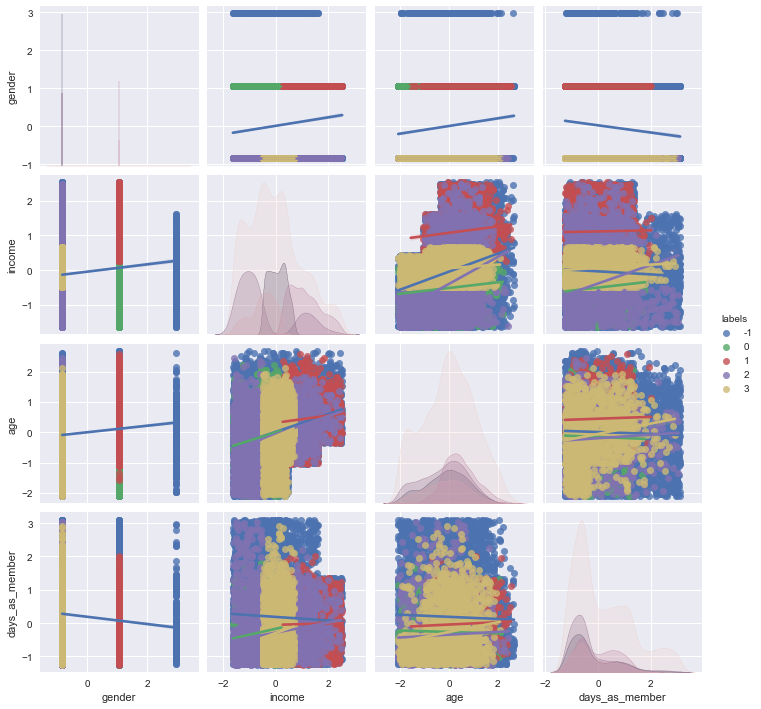

In [221]:
personal_details = ['gender', 'income', 'age', 'days_as_member', 'labels']
sb.pairplot(df_cluster[personal_details], hue = 'labels', kind = 'reg');

In [222]:
cust_transaction_2 = pd.read_csv('customer_transactions.csv')
cust_transaction_2

,customer_id,age,age_range,gender,income,became_member_on,days_as_member,total_completed,total_viewed,total_received,percent_completed,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed
0,0610b486422d4921ae7d2bf64640c50b,55,50-59,F,112000.0,2017-07-15,382,1,0,2,0.000000,77.01,25.670000,3,1,2,0.500000,0,0,0.000000
1,78afa995795e4d85b5d9ceeca43f5fef,75,70-79,F,100000.0,2017-05-09,449,3,4,4,0.750000,159.27,22.752857,7,3,9,0.333333,0,0,0.000000
2,e2127556f4f64592b11af22de27a7932,68,60-69,M,70000.0,2018-04-26,97,2,3,4,0.500000,57.73,19.243333,3,1,3,0.333333,2,5,0.400000
3,389bc3fa690240e798340f5a15918d5c,65,60-69,M,53000.0,2018-02-09,173,5,6,6,0.833333,36.43,12.143333,3,2,11,0.181818,2,6,0.333333
4,2eeac8d8feae4a8cad5a6af0499a211d,58,50-59,M,51000.0,2017-11-11,263,1,2,3,0.333333,15.62,3.905000,4,0,0,0.181818,2,5,0.400000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,6d5f3a774f3d4714ab0c092238f3a1d7,45,40-49,F,54000.0,2018-06-04,58,0,3,3,0.000000,20.03,2.861429,7,1,2,0.500000,1,2,0.500000
14821,2cb4f97358b841b9a9773a7aa05a9d77,61,60-69,M,72000.0,2018-07-13,19,1,1,3,0.333333,25.97,3.710000,7,1,2,0.500000,0,0,0.000000
14822,01d26f638c274aa0b965d24cefe3183f,49,40-49,M,73000.0,2017-01-26,552,0,1,3,0.000000,39.74,4.967500,8,0,0,0.500000,1,1,1.000000
14823,9dc1421481194dcd9400aec7c9ae6366,83,80+,F,50000.0,2016-03-07,877,3,3,3,1.000000,189.67,13.547857,14,3,9,0.333333,0,0,0.000000


In [223]:
cust_transaction_2['labels'] = df_cluster['labels']

In [224]:
cust_transaction_2

,customer_id,age,age_range,gender,income,became_member_on,days_as_member,total_completed,total_viewed,total_received,...,total_spent,avg_spent,num_transactions,completed_bogo,num_bogos,bogo_percent_completed,completed_discount,num_discounts,discount_percent_completed,labels
0,0610b486422d4921ae7d2bf64640c50b,55,50-59,F,112000.0,2017-07-15,382,1,0,2,...,77.01,25.670000,3,1,2,0.500000,0,0,0.000000,-1
1,78afa995795e4d85b5d9ceeca43f5fef,75,70-79,F,100000.0,2017-05-09,449,3,4,4,...,159.27,22.752857,7,3,9,0.333333,0,0,0.000000,-1
2,e2127556f4f64592b11af22de27a7932,68,60-69,M,70000.0,2018-04-26,97,2,3,4,...,57.73,19.243333,3,1,3,0.333333,2,5,0.400000,3
3,389bc3fa690240e798340f5a15918d5c,65,60-69,M,53000.0,2018-02-09,173,5,6,6,...,36.43,12.143333,3,2,11,0.181818,2,6,0.333333,-1
4,2eeac8d8feae4a8cad5a6af0499a211d,58,50-59,M,51000.0,2017-11-11,263,1,2,3,...,15.62,3.905000,4,0,0,0.181818,2,5,0.400000,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14820,6d5f3a774f3d4714ab0c092238f3a1d7,45,40-49,F,54000.0,2018-06-04,58,0,3,3,...,20.03,2.861429,7,1,2,0.500000,1,2,0.500000,0
14821,2cb4f97358b841b9a9773a7aa05a9d77,61,60-69,M,72000.0,2018-07-13,19,1,1,3,...,25.97,3.710000,7,1,2,0.500000,0,0,0.000000,-1
14822,01d26f638c274aa0b965d24cefe3183f,49,40-49,M,73000.0,2017-01-26,552,0,1,3,...,39.74,4.967500,8,0,0,0.500000,1,1,1.000000,-1
14823,9dc1421481194dcd9400aec7c9ae6366,83,80+,F,50000.0,2016-03-07,877,3,3,3,...,189.67,13.547857,14,3,9,0.333333,0,0,0.000000,-1


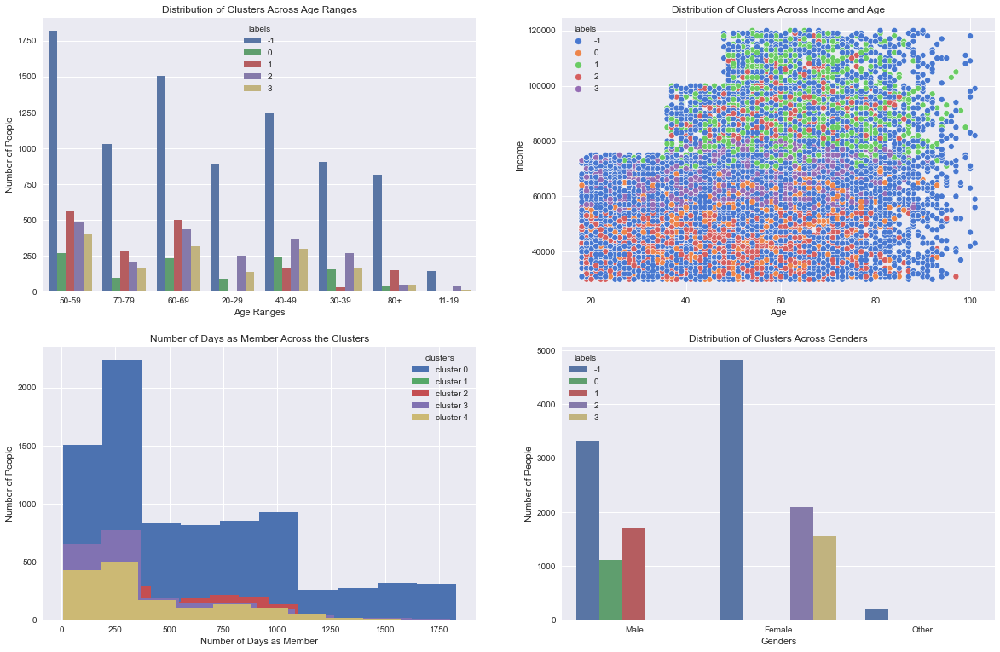

In [225]:
fig, axes = plt.subplots(nrows = 2, ncols = 2, figsize = (20, 13))

#Visualizing clusters across age ranges
sb.countplot(data = cust_transaction_2, x = 'age_range', hue = 'labels', ax = axes[0,0]);
axes[0,0].set_title('Distribution of Clusters Across Age Ranges');
axes[0,0].set_xlabel('Age Ranges');
axes[0,0].set_ylabel('Number of People');

#Visualizing clusters across incomes and ages
sb.scatterplot(data = cust_transaction_2, x = 'age', y = 'income', hue = 'labels', palette = sb.color_palette('muted', n_colors = 5), ax = axes[0,1]);
axes[0,1].set_title('Distribution of Clusters Across Income and Age');
axes[0,1].set_xlabel('Age');
axes[0,1].set_ylabel('Income');

#Visualizing how long members have been members in a stacked histogram
days_as_member_0 = cust_transaction_2[cust_transaction_2['labels'] == -1]['days_as_member']
days_as_member_1 = cust_transaction_2[cust_transaction_2['labels'] == 0]['days_as_member']
days_as_member_2 = cust_transaction_2[cust_transaction_2['labels'] == 1]['days_as_member']
days_as_member_3 = cust_transaction_2[cust_transaction_2['labels'] == 2]['days_as_member']
days_as_member_4 = cust_transaction_2[cust_transaction_2['labels'] == 3]['days_as_member']

axes[1,0].hist(days_as_member_0, stacked = True);
axes[1,0].hist(days_as_member_1, stacked = True);
axes[1,0].hist(days_as_member_2, stacked = True);
axes[1,0].hist(days_as_member_3, stacked = True);
axes[1,0].hist(days_as_member_4, stacked = True);
axes[1,0].legend(title = 'clusters', labels = ['cluster 0', 'cluster 1', 'cluster 2', 'cluster 3', 'cluster 4']);
axes[1,0].set_title('Number of Days as Member Across the Clusters');
axes[1,0].set_xlabel('Number of Days as Member');
axes[1,0].set_ylabel('Number of People');

#Visualizing clusters across age ranges
sb.countplot(data = cust_transaction_2, x = 'gender', hue = 'labels', ax = axes[1,1]);
axes[1,1].set_title('Distribution of Clusters Across Genders');
axes[1,1].set_xlabel('Genders');
axes[1,1].set_ylabel('Number of People');
plt.sca(axes[1,1]);
plt.xticks(range(3), ['Male', 'Female', 'Other']);

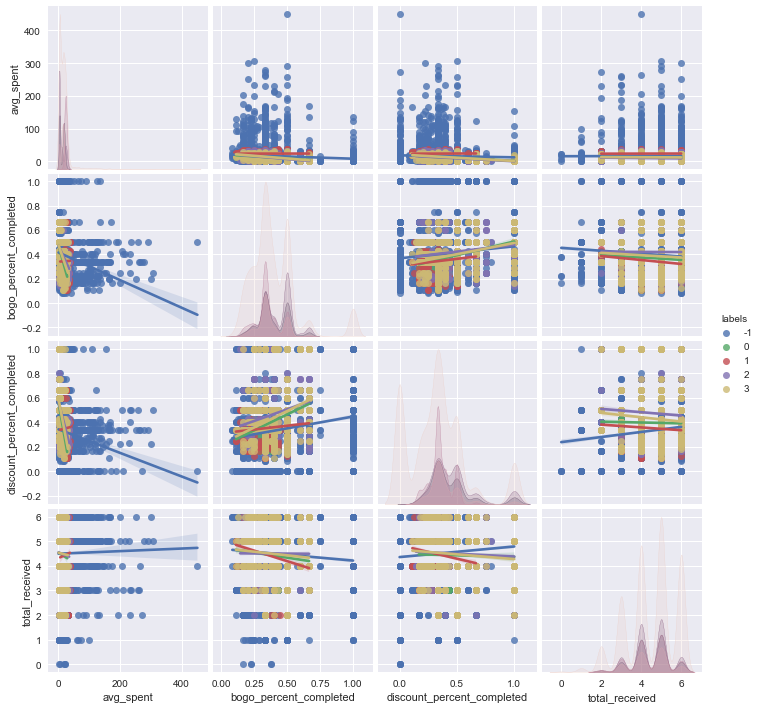

In [226]:
behavioral_attributes = ['labels', 'avg_spent', 'bogo_percent_completed', 'discount_percent_completed', 'total_received']
sb.pairplot(cust_transaction_2[behavioral_attributes], hue = 'labels', kind = 'reg');

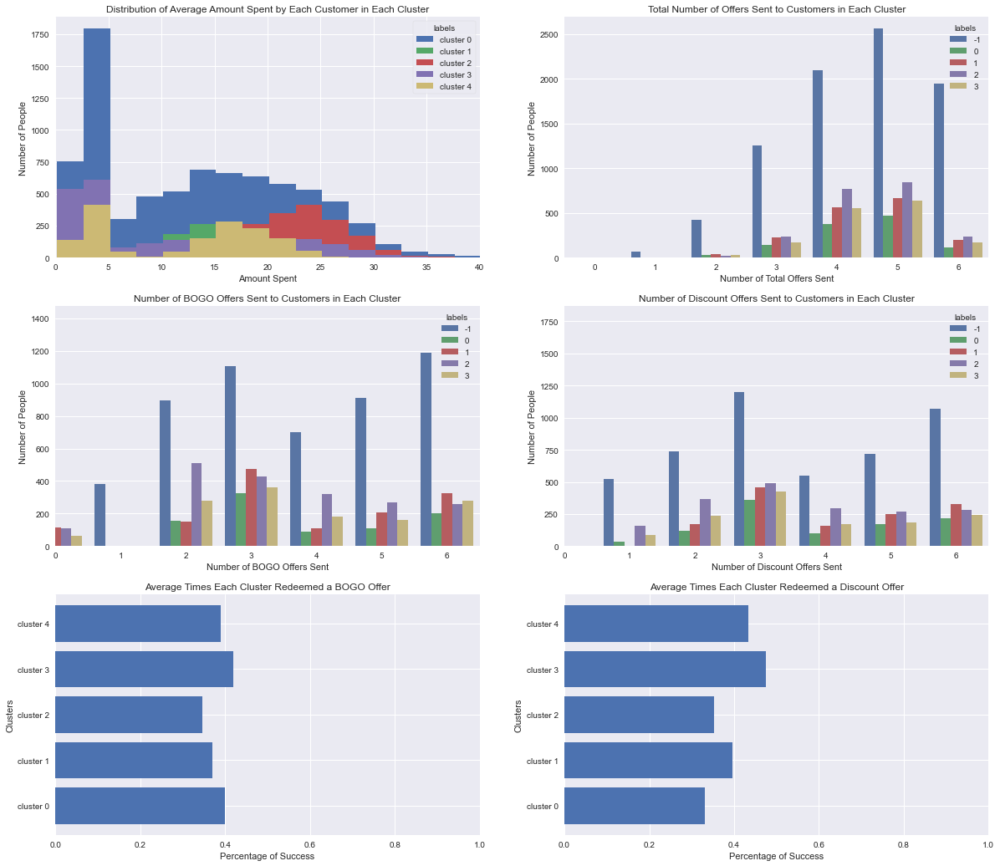

In [227]:
#Visualizing the behavioral attributes in more detail
fig, axes = plt.subplots(nrows = 3, ncols = 2, figsize = (20, 18))

#Visualizing the average amount spent by customers in each respective cluster
avg_spent_0 = cust_transaction_2[cust_transaction_2['labels'] == -1]['avg_spent']
avg_spent_1 = cust_transaction_2[cust_transaction_2['labels'] == 0]['avg_spent']
avg_spent_2 = cust_transaction_2[cust_transaction_2['labels'] == 1]['avg_spent']
avg_spent_3 = cust_transaction_2[cust_transaction_2['labels'] == 2]['avg_spent']
avg_spent_4 = cust_transaction_2[cust_transaction_2['labels'] == 3]['avg_spent']
avg_spent_bins = np.arange(min(cust_transaction_2['avg_spent']), max(cust_transaction_2['avg_spent'] + 2.5), 2.5)
axes[0,0].hist(avg_spent_0, bins = avg_spent_bins, stacked = True);
axes[0,0].hist(avg_spent_1, bins = avg_spent_bins, stacked = True);
axes[0,0].hist(avg_spent_2, bins = avg_spent_bins, stacked = True);
axes[0,0].hist(avg_spent_3, bins = avg_spent_bins, stacked = True);
axes[0,0].hist(avg_spent_4, bins = avg_spent_bins, stacked = True);
axes[0,0].set_xlim([0, 40]);
axes[0,0].legend(title = 'labels', labels = ['cluster 0', 'cluster 1', 'cluster 2', 'cluster 3', 'cluster 4'], frameon = True);
axes[0,0].set_title('Distribution of Average Amount Spent by Each Customer in Each Cluster');
axes[0,0].set_xlabel('Amount Spent');
axes[0,0].set_ylabel('Number of People');

#Visualizing the total number of offers sent to the customers
sb.countplot(data = cust_transaction_2, x = 'total_received', hue = 'labels', ax = axes[0,1]);
axes[0,1].set_title('Total Number of Offers Sent to Customers in Each Cluster');
axes[0,1].set_xlabel('Number of Total Offers Sent');
axes[0,1].set_ylabel('Number of People');

#Visualizing the number of BOGO offers sent to the customers
sb.countplot(data = cust_transaction_2, x = 'num_bogos', hue = 'labels', ax = axes[1,0]);
axes[1,0].set_title('Number of BOGO Offers Sent to Customers in Each Cluster');
axes[1,0].set_xlabel('Number of BOGO Offers Sent');
axes[1,0].set_ylabel('Number of People');
axes[1,0].set_xlim([0, 6.5]);

#Visualizing the number of discount offers sent to the customers
sb.countplot(data = cust_transaction_2, x = 'num_discounts', hue = 'labels', ax = axes[1,1]);
axes[1,1].set_title('Number of Discount Offers Sent to Customers in Each Cluster');
axes[1,1].set_xlabel('Number of Discount Offers Sent');
axes[1,1].set_ylabel('Number of People');
axes[1,1].set_xlim([0, 6.5]);

#Visualizing the mean of the how often customers completed bogo offers in each cluster
bogo_pct_completed_0 = cust_transaction_2[cust_transaction_2['labels'] == -1]['bogo_percent_completed'].mean()
bogo_pct_completed_1 = cust_transaction_2[cust_transaction_2['labels'] == 0]['bogo_percent_completed'].mean()
bogo_pct_completed_2 = cust_transaction_2[cust_transaction_2['labels'] == 1]['bogo_percent_completed'].mean()
bogo_pct_completed_3 = cust_transaction_2[cust_transaction_2['labels'] == 2]['bogo_percent_completed'].mean()
bogo_pct_completed_4 = cust_transaction_2[cust_transaction_2['labels'] == 3]['bogo_percent_completed'].mean()
bogo_pct_completed_data = [bogo_pct_completed_0, bogo_pct_completed_1, bogo_pct_completed_2, bogo_pct_completed_3, bogo_pct_completed_4]
y_pos = np.arange(len(bogo_pct_completed_data))
bogo_tick_labels = ['cluster 0', 'cluster 1', 'cluster 2', 'cluster 3', 'cluster 4']
axes[2,0].barh(y_pos, bogo_pct_completed_data, tick_label = bogo_tick_labels);
axes[2,0].set_xlim([0, 1]);
axes[2,0].set_title('Average Times Each Cluster Redeemed a BOGO Offer');
axes[2,0].set_xlabel('Percentage of Success');
axes[2,0].set_ylabel('Clusters');

#Visualizing the mean of the how often customers completed discount offers in each cluster
discount_pct_completed_0 = cust_transaction_2[cust_transaction_2['labels'] == -1]['discount_percent_completed'].mean()
discount_pct_completed_1 = cust_transaction_2[cust_transaction_2['labels'] == 0]['discount_percent_completed'].mean()
discount_pct_completed_2 = cust_transaction_2[cust_transaction_2['labels'] == 1]['discount_percent_completed'].mean()
discount_pct_completed_3 = cust_transaction_2[cust_transaction_2['labels'] == 2]['discount_percent_completed'].mean()
discount_pct_completed_4 = cust_transaction_2[cust_transaction_2['labels'] == 3]['discount_percent_completed'].mean()
discount_pct_completed_data = [discount_pct_completed_0, discount_pct_completed_1, discount_pct_completed_2, discount_pct_completed_3, discount_pct_completed_4]
y_pos = np.arange(len(discount_pct_completed_data))
discount_tick_labels = ['cluster 0', 'cluster 1', 'cluster 2', 'cluster 3', 'cluster 4']
axes[2,1].barh(y_pos, discount_pct_completed_data, tick_label = discount_tick_labels);
axes[2,1].set_xlim([0, 1]);
axes[2,1].set_title('Average Times Each Cluster Redeemed a Discount Offer');
axes[2,1].set_xlabel('Percentage of Success');
axes[2,1].set_ylabel('Clusters');


#discount_percent_cmompleted
#bogo_percent_completed